In [1]:
import importlib
import time
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [5]:
importlib.reload(assimilate)
importlib.reload(utilities)

<module 'multi_loc.utilities' from '/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py'>

In [43]:
N_X = 36 # size of X (coarse variable)
N_YpX = 10 # size of Y (fine variable) corresponding to each X
N_Y = N_X * N_YpX
F = 10
c = 10
b = 10
h = 1
N_eX = 500
N_eXY = 20

In [17]:
def L96_multi(X, Y, F=8, c=10, b=10, h=1):
    """

    """
    N_X = X.size
    N_Y = Y.size
    N_YpX = N_Y//N_X
    if N_X*N_YpX != N_Y:
        raise Exception('Size of X should evenly divide size of Y.')

    Y_sum = Y.reshape(N_X, N_YpX).sum(axis=1)
    
    Xp1 = np.roll(X, -1, axis=0)
    Xm2 = np.roll(X, 2, axis=0)
    Xm1 = np.roll(X, 1, axis=0)
    dXdt = (Xp1 - Xm2) * Xm1 - X + F - (h * c) / b * Y_sum
    
    X_forcing =  np.repeat(X, N_YpX)
    Ym1 = np.roll(Y, 1, axis=0)
    Yp2 = np.roll(Y, -2, axis=0)
    Yp1 = np.roll(Y, -1, axis=0)
    dYdt = (c * b)*(Ym1 - Yp2) * Yp1 - c*Y + (h*c)/b*X_forcing
    return dXdt, dYdt

In [22]:
def return_L96_multi_data(X0, Y0, t, F=8, b=10, c=10, h=1):
    N_X = X0.size
    N_Y = Y0.size
    N_YpX = N_Y//N_X
    if N_X*N_YpX != N_Y:
        raise Exception('Size of X0 should evenly divide size of Y0.')
    def this_L96_multi(XY_1D, t):
        X = XY_1D[:N_X]
        Y = XY_1D[N_X:]
        dXdt, dYdt = L96_multi(X, Y, F=F, b=b, c=c, h=h)
        dXYdt = np.concatenate([dXdt, dYdt])
        return dXYdt
    XY0 = np.concatenate([X0, Y0])
    XY = integrate.odeint(this_L96_multi, XY0, t)
    XY = XY.T
    X = XY[:N_X]
    Y = XY[N_X:]
    return X, Y

# Random initialization for X and Y

In [10]:
X0 = np.random.uniform(low=-5, high=10, size=N_X)
Y0 = np.random.uniform(low=-0.5, high=1, size=N_Y)

In [24]:
t = np.linspace(0, 20, 100)

In [25]:
X, Y = return_L96_multi_data(X0, Y0, t, F=F, b=b, c=c, h=h)

In [30]:
theta_Y = np.linspace(0, 2 * np.pi, N_Y + 1)

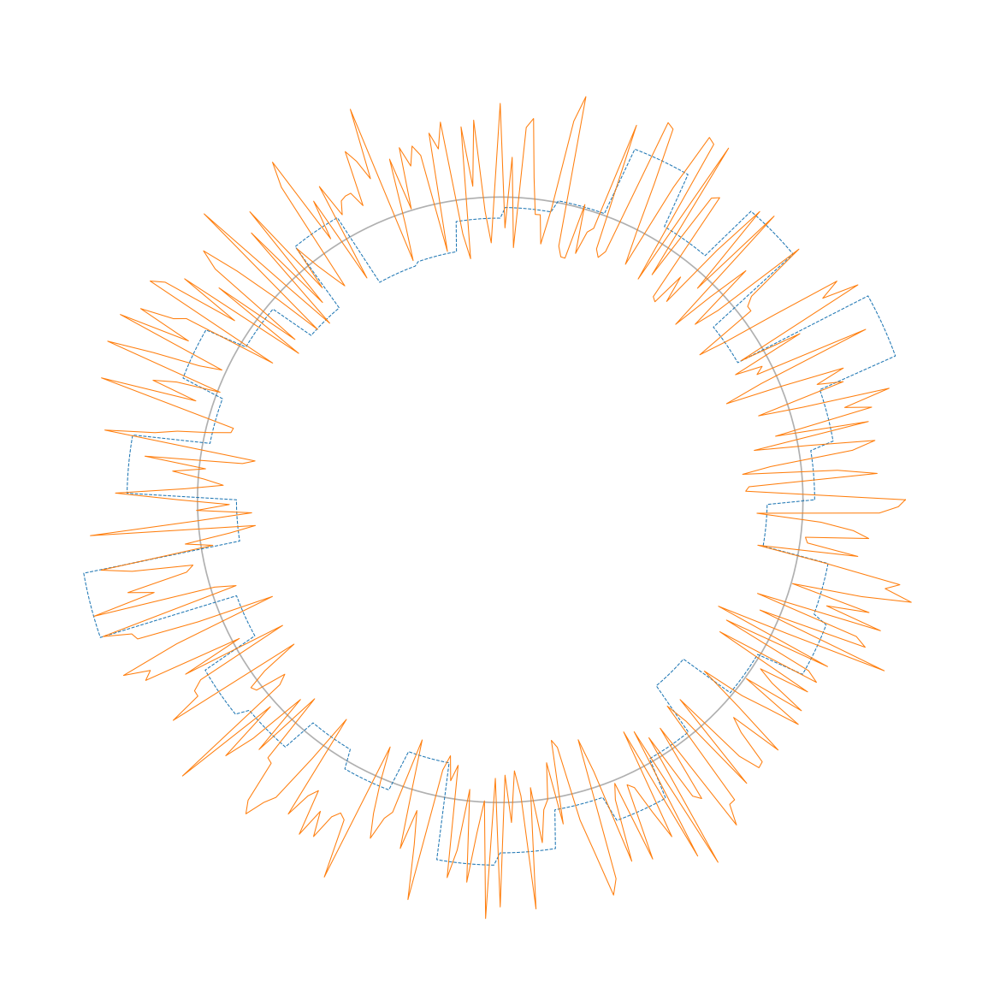

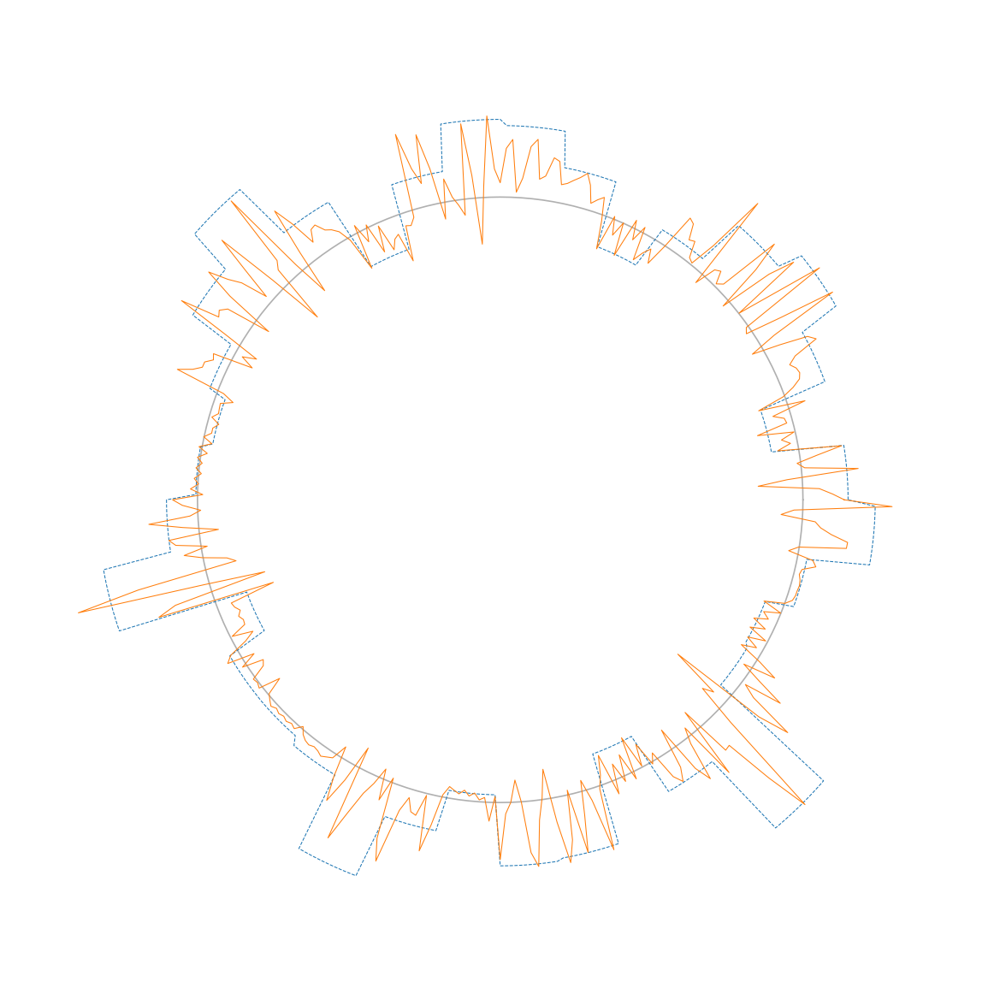

In [31]:
for ii in [0, -1]:
    X_to_plot = .1 * X[:, ii]
    X_to_plot = np.repeat(X_to_plot, N_YpX)
    X_to_plot = np.concatenate([X_to_plot,
                                [X_to_plot[0]]])
    Y_to_plot = Y[:, ii]
    Y_to_plot = np.concatenate([Y_to_plot, 
                                [Y_to_plot[0]]])
    
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    plt.polar(theta_Y, X_to_plot, '--', linewidth=0.5)
    plt.polar(theta_Y, Y_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-2.5, 1.5])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

# use end of run as init

In [32]:
X0 = X[:, -1]
Y0 = Y[:, -1]

In [33]:
T = 1000
dt = 0.05
N = int(T/dt + 1)
t = np.linspace(0, T, N)

# long run to generate ensemble

In [35]:
X, Y = return_L96_multi_data(X0, Y0, t, F=F, b=b, c=c, h=h)

np.save('./X_long_run.npy', X)
np.save('./Y_long_run.npy', Y)
# X = np.load('./X_long_run.npy')
# Y = np.load('./Y_long_run.npy')

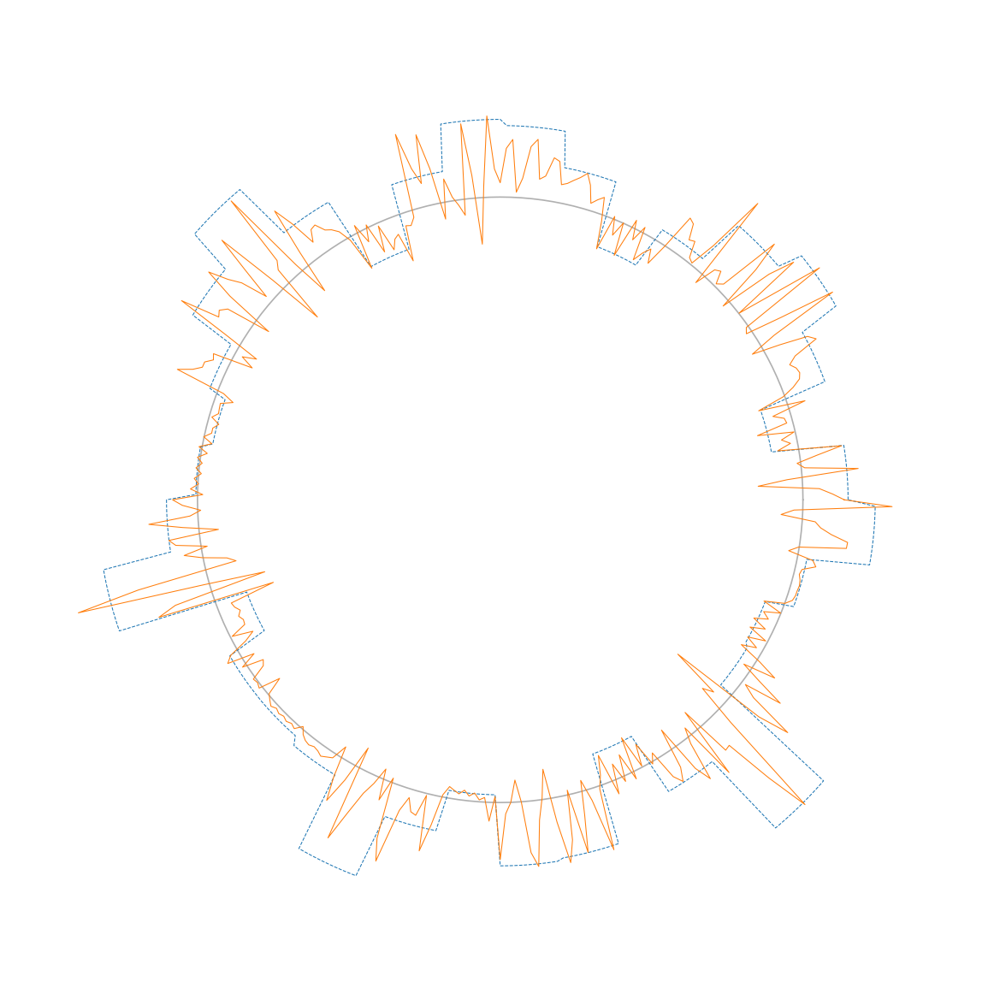

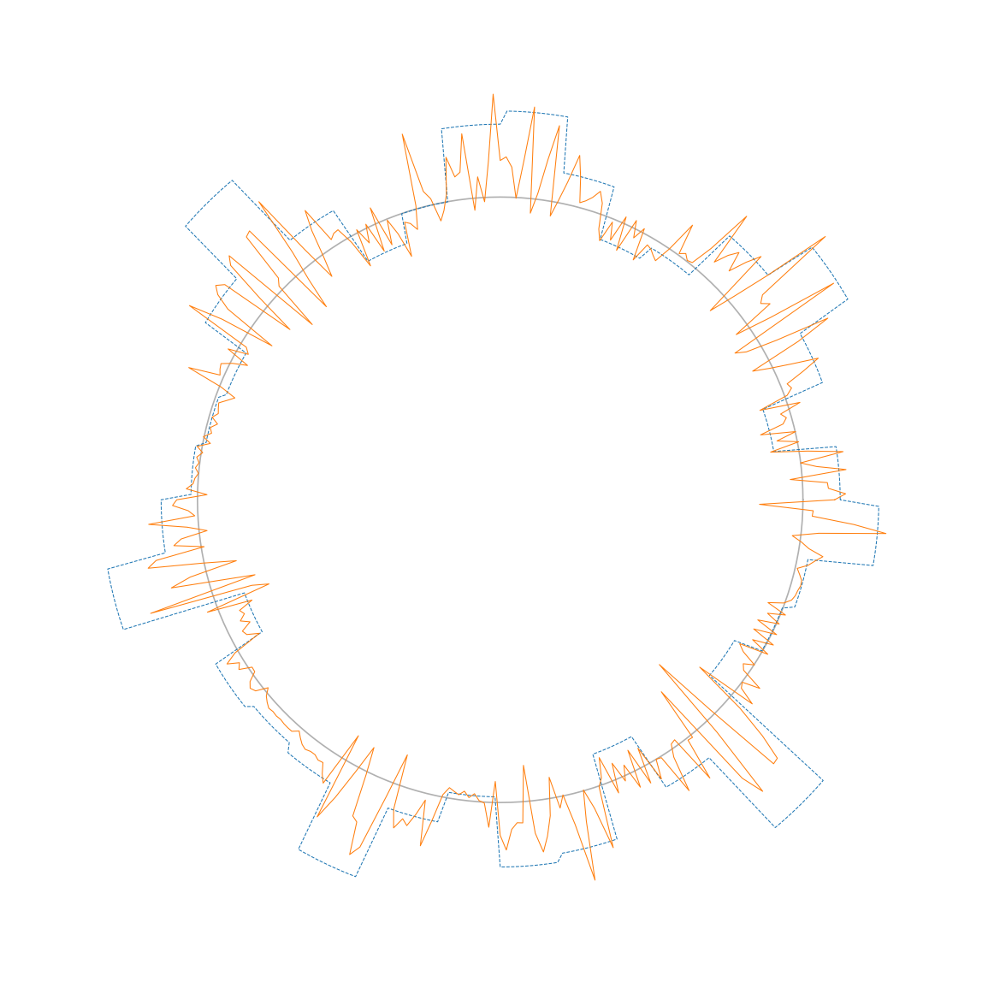

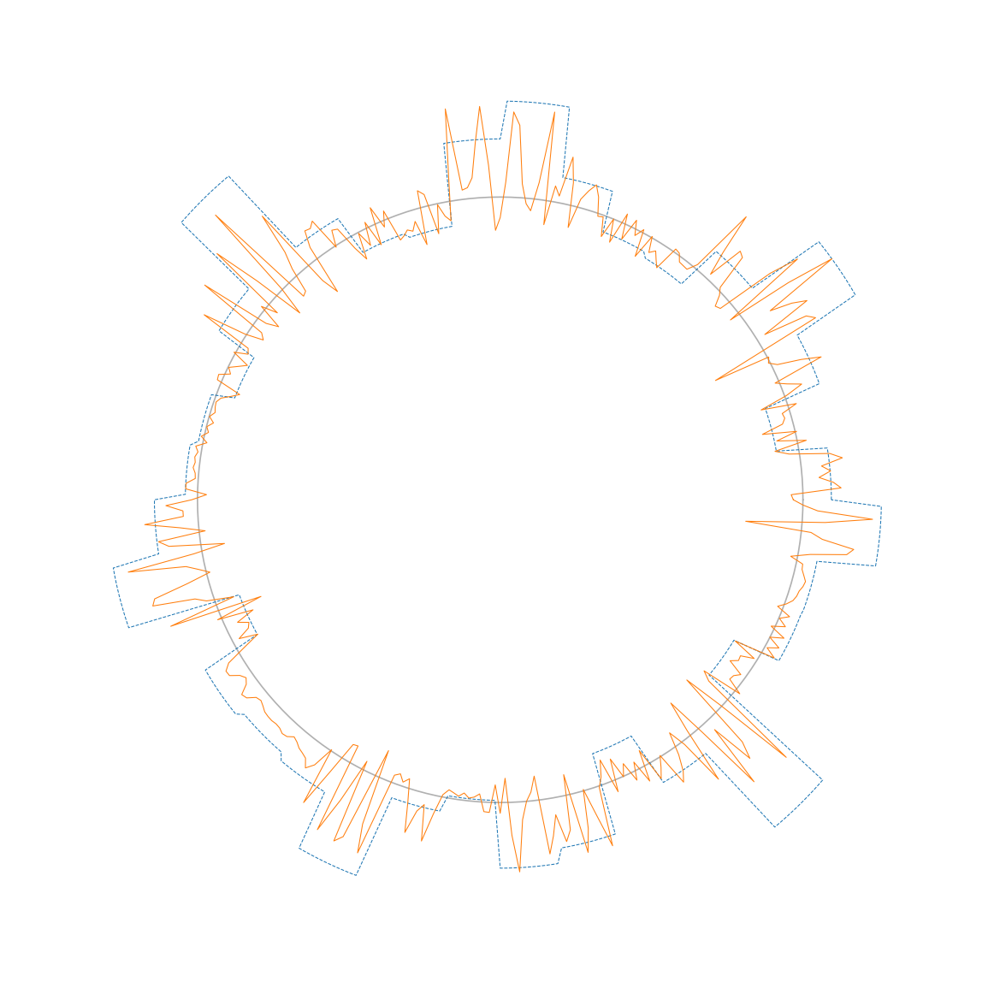

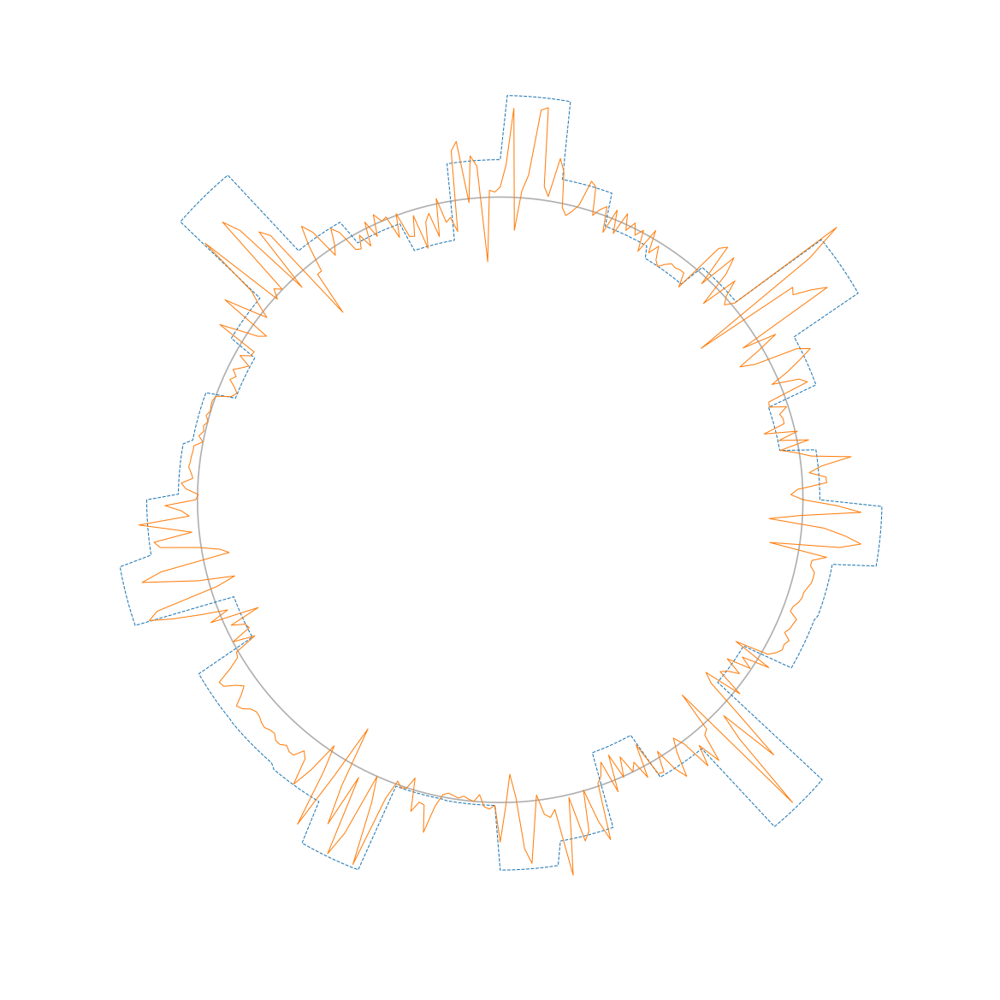

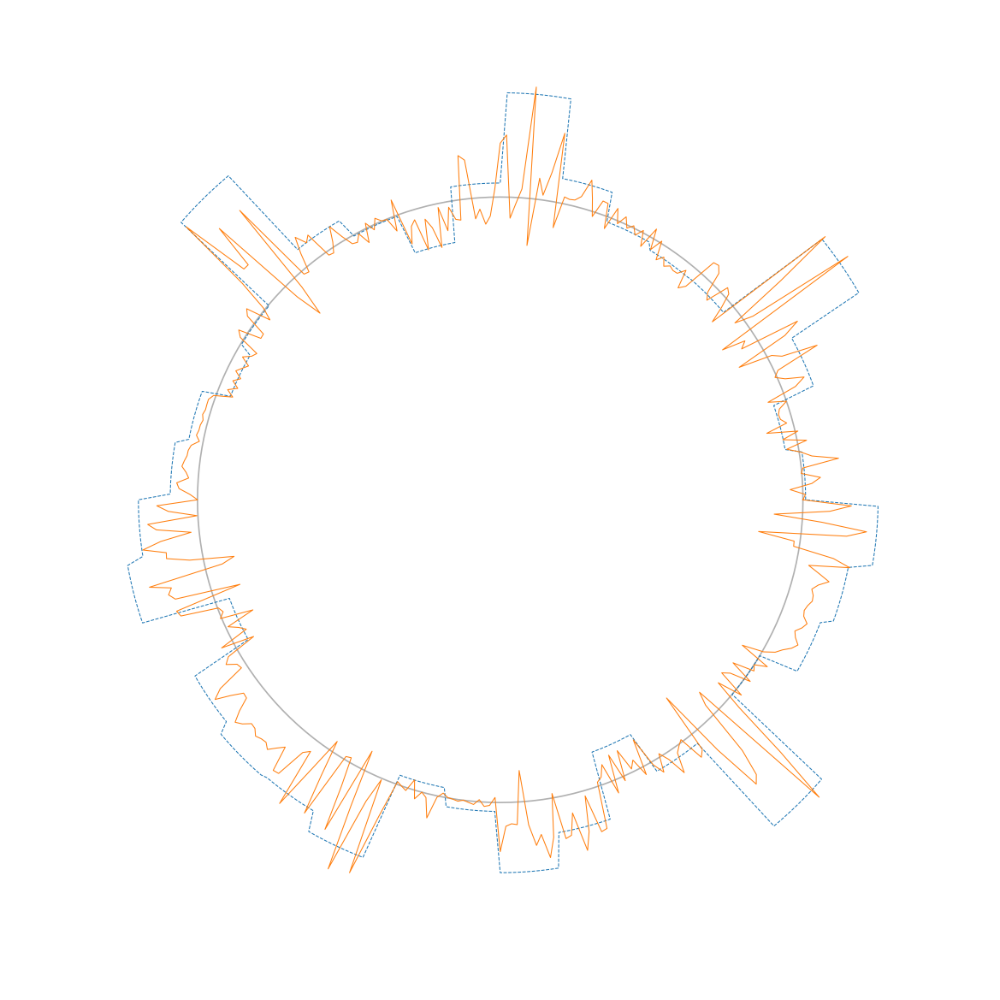

...

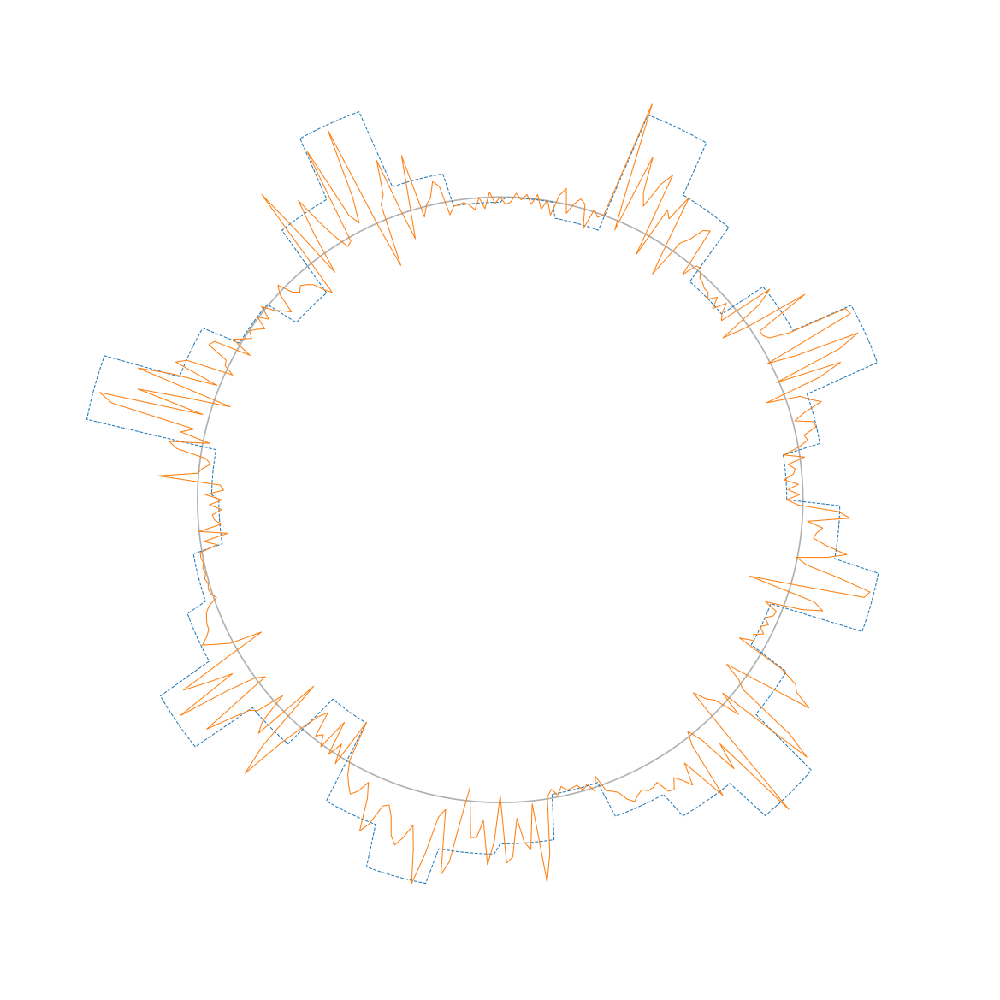

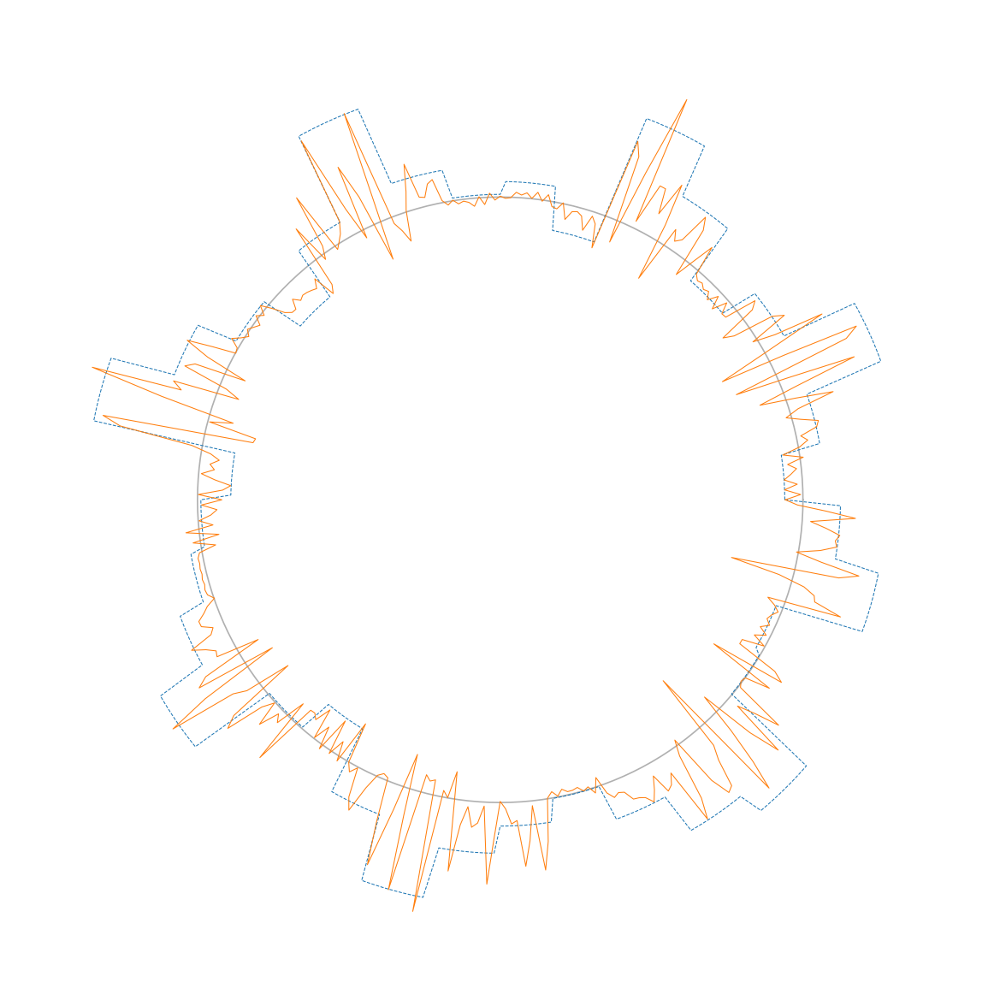

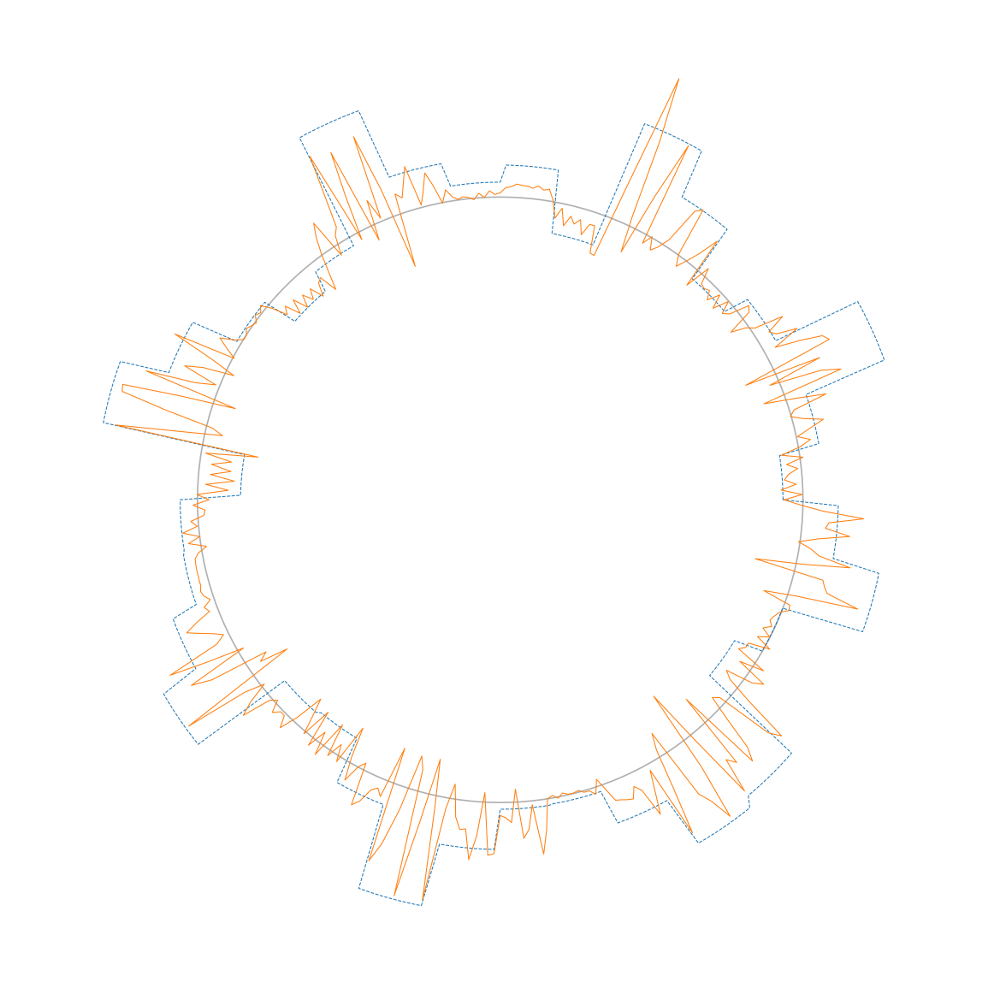

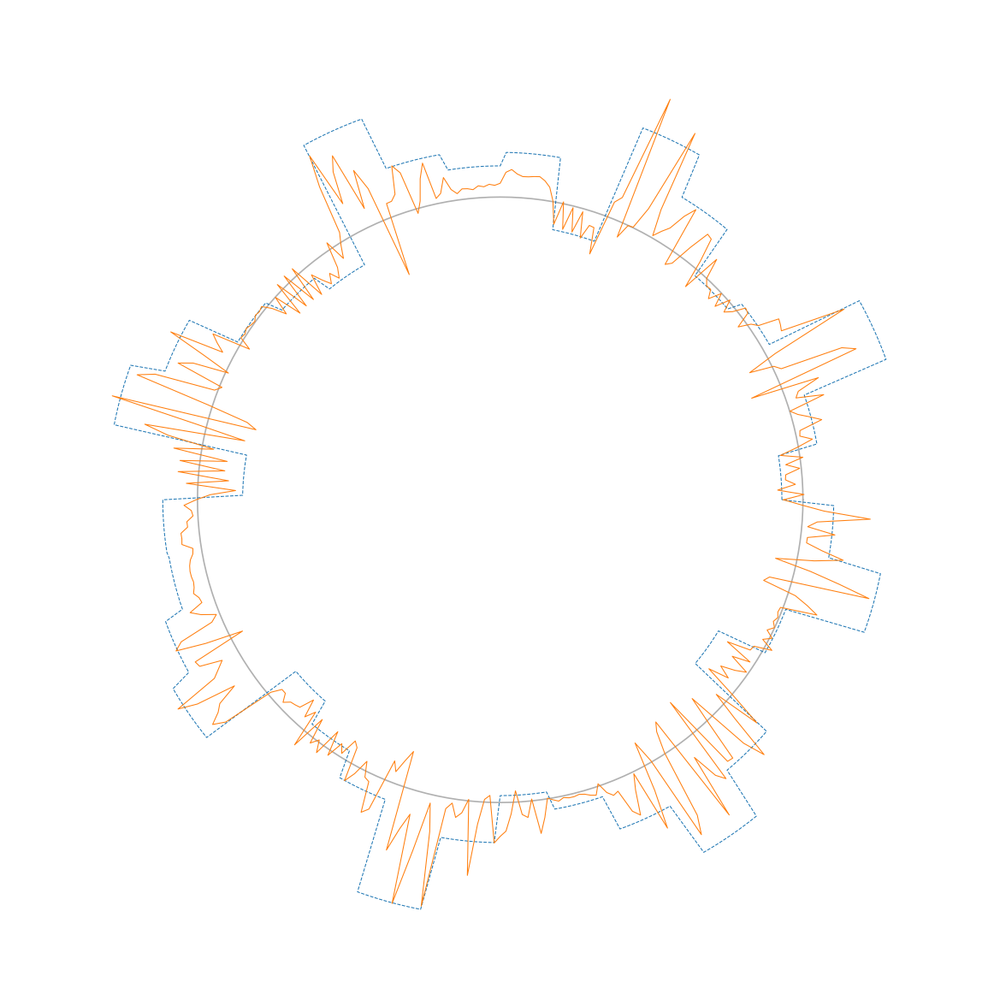

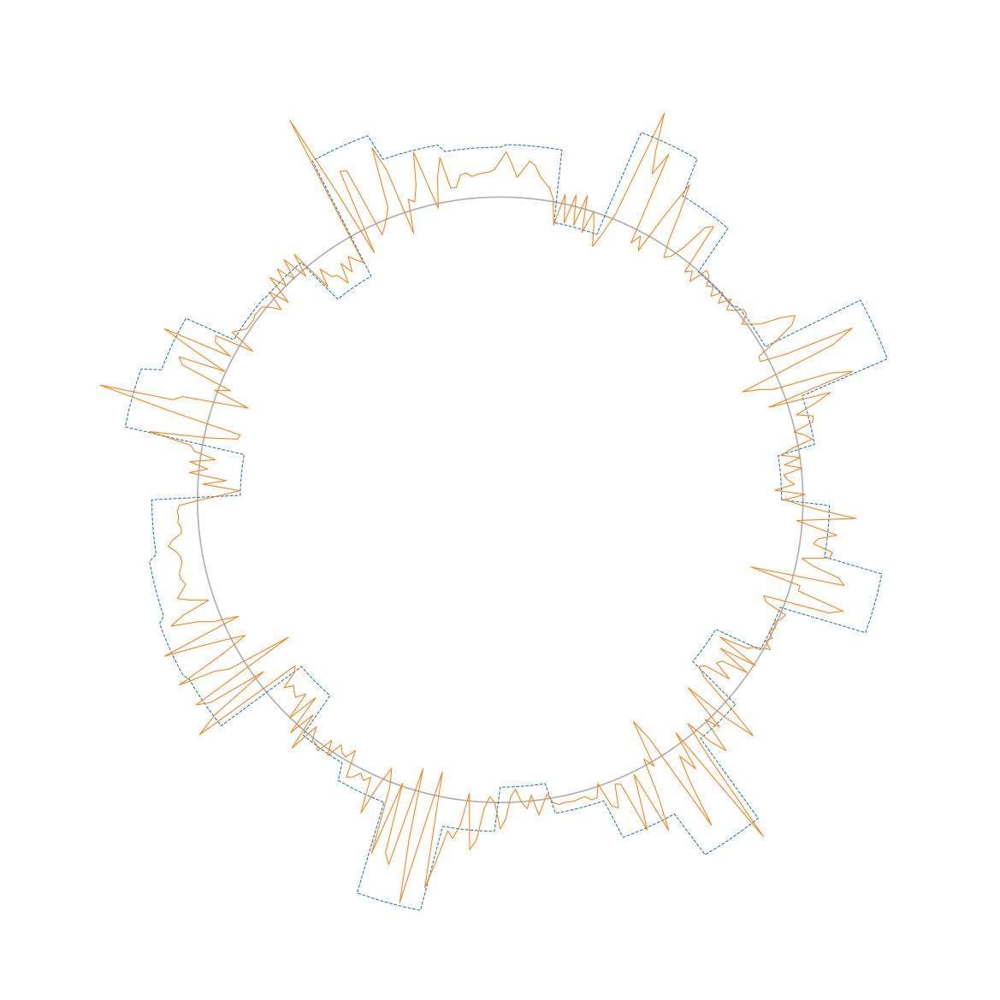

In [36]:
for ii in range(20): #range(XY.shape[0]):
#     ii = 5 * ii
    X_to_plot = .1 * X[:, ii]
    X_to_plot = np.repeat(X_to_plot, N_YpX)
    X_to_plot = np.concatenate([X_to_plot,
                                [X_to_plot[0]]])
    Y_to_plot = Y[:, ii]
    Y_to_plot = np.concatenate([Y_to_plot, 
                                [Y_to_plot[0]]])
    
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    plt.polar(theta_Y, X_to_plot, '--', linewidth=0.5)
    plt.polar(theta_Y, Y_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-2.5, 1.5])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

In [38]:
def generate_XY_X_ens(X_ts, Y_ts, N_eXY, N_eX):
    """

    """
    N_t = X_ts.shape[1]
    fine_indices = np.random.choice(N_t, size=N_eXY, replace=False)
    Y_ens = Y_ts[:, fine_indices]
    XfY_ens = X_ts[:, fine_indices]
    XY_ens = np.concatenate([XfY_ens, Y_ens], axis=0)
    
    coarse_indices = np.random.choice(N_t, size=N_eX, replace=False)
    X_ens = X_ts[:, coarse_indices]
    return XY_ens, X_ens

In [44]:
XY_ens, X_ens = generate_XY_X_ens(X, Y, N_eXY, N_eX)

np.save('XY_ens', XY_ens)
np.save('X_ens', X_ens)

# XY_ens = np.load('XY_ens')
# X_ens = np.load('X_ens')

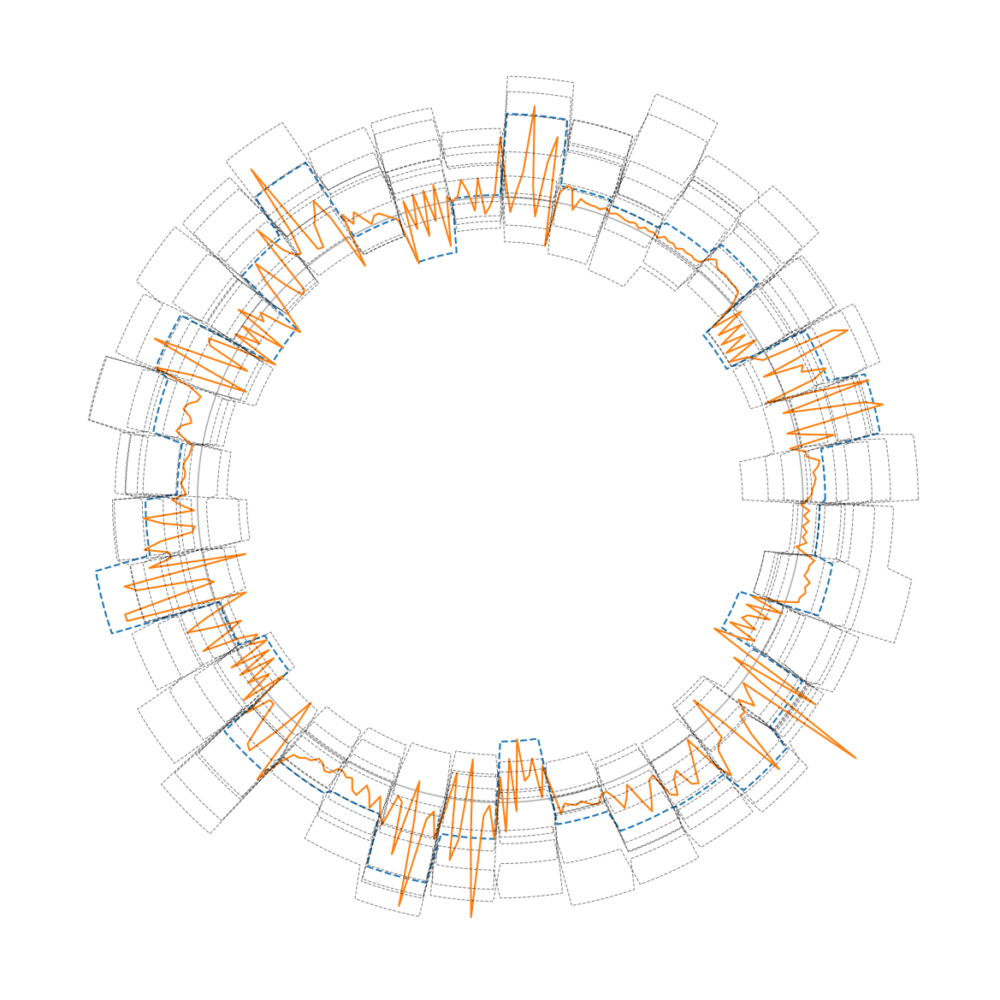

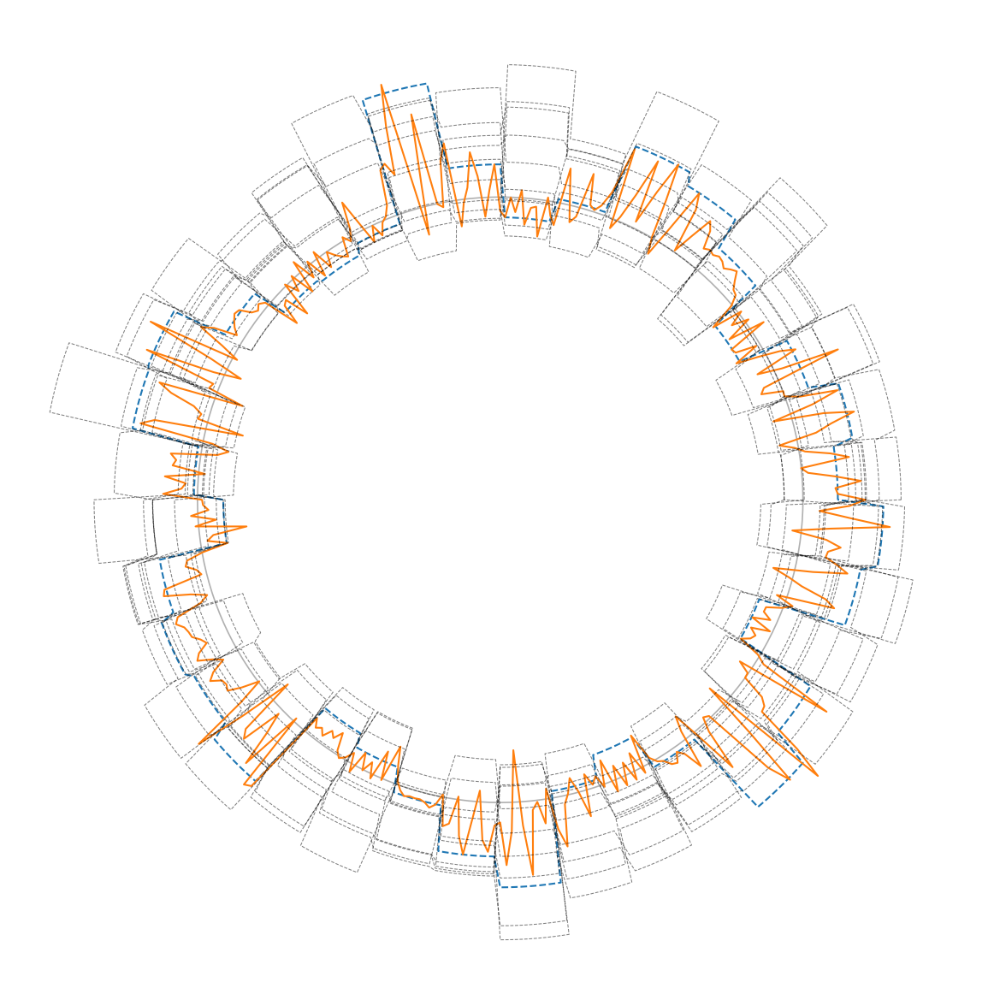

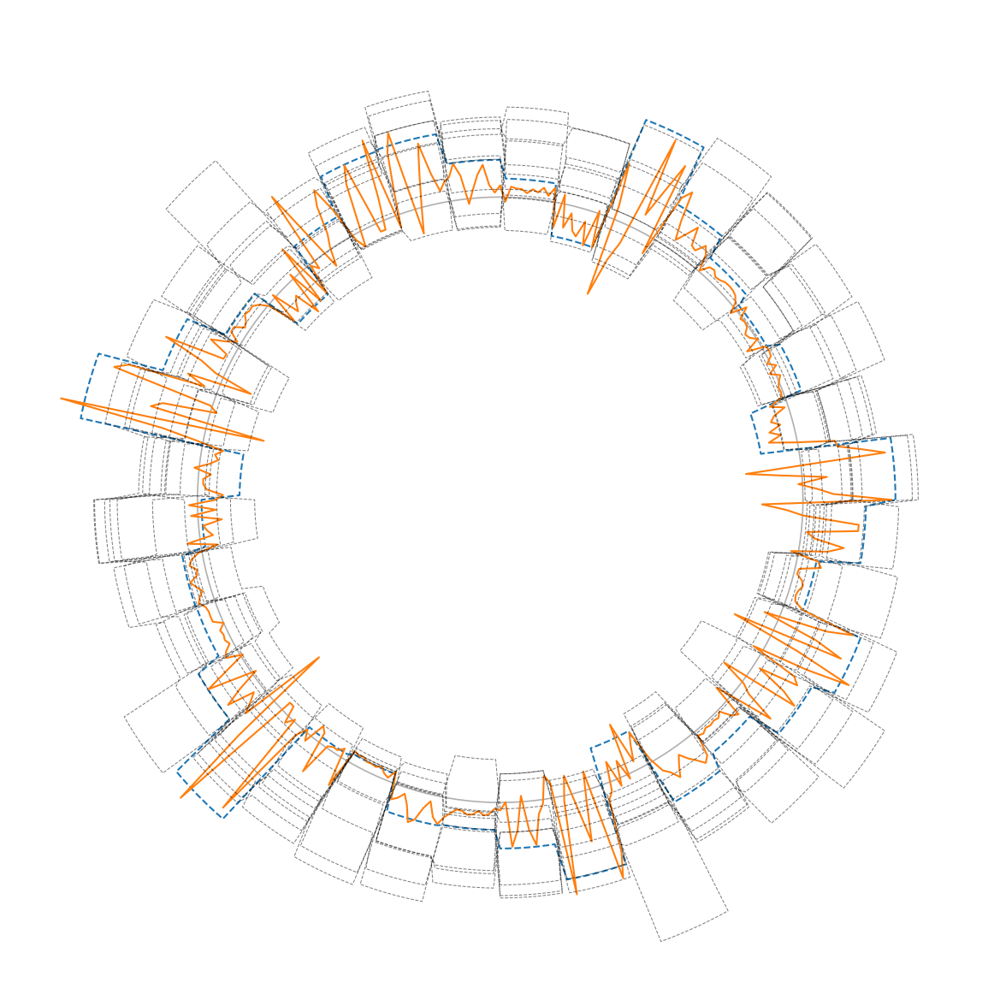

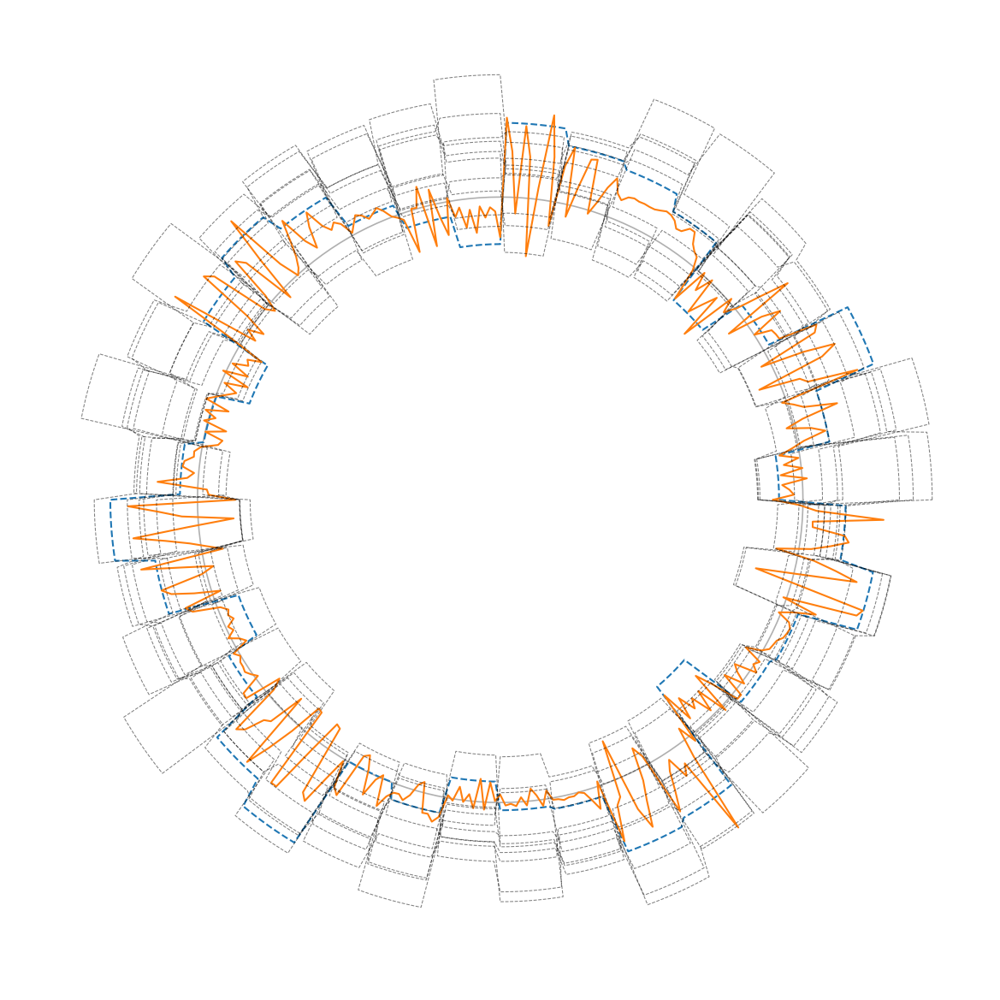

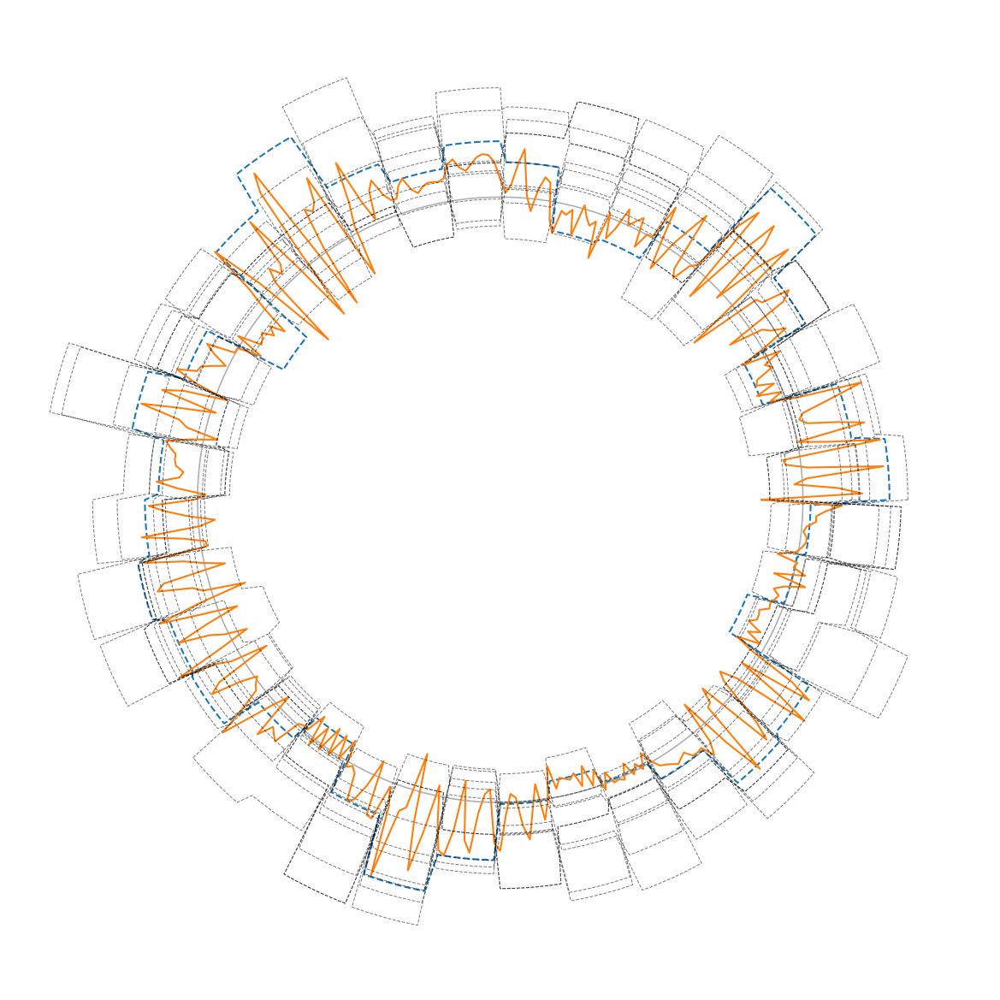

In [51]:
for kk in range(5): #  range(N_eXY): #
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    
    X_to_plot = .1 * XY_ens[:N_X, kk]
    X_to_plot = np.repeat(X_to_plot, N_YpX)
    X_to_plot = np.concatenate([X_to_plot,
                                [X_to_plot[0]]])
    Y_to_plot = XY_ens[N_X:, kk]
    Y_to_plot = np.concatenate([Y_to_plot, 
                                [Y_to_plot[0]]])
    plt.polar(theta_Y, X_to_plot, '--', linewidth=1)

    plt.polar(theta_Y, Y_to_plot, linewidth=1)
    
    to_plot = np.random.choice(N_eX, 10)
    for ii in to_plot:
        X_to_plot = .1 * X_ens[:, ii]
        X_to_plot = np.repeat(X_to_plot, N_YpX)
        X_to_plot = np.concatenate([X_to_plot,
                                    [X_to_plot[0]]])
        plt.polar(theta_Y, X_to_plot, '--k', linewidth=0.5, alpha=0.5)

    

    plt.yticks([0])
    plt.ylim([-2.5, 1.5])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

In [512]:
# def return_ens_mean(XY_ens, N_ec):
#     X_ens_mean = np.mean(XY_ens[:N_ec], axis=(0, -1))
#     Y_ens_mean = np.mean(XY_ens[N_ec:], axis=-1)
#     XY_ens_mean = np.concatenate([X_ens_mean[None, :], Y_ens_mean], axis=0)
#     return XY_ens_mean

# def return_ens_sd(XY_ens, N_ec):
#     X_ens_sd = np.std(XY_ens[:N_ec], axis=(0, -1))
#     Y_ens_sd = np.std(XY_ens[N_ec:], axis=-1)
#     XY_ens_sd = np.concatenate([X_ens_sd[None, :], Y_ens_sd], axis=0)
#     return XY_ens_sd

Text(0.5,1.05,'Every 40th member')

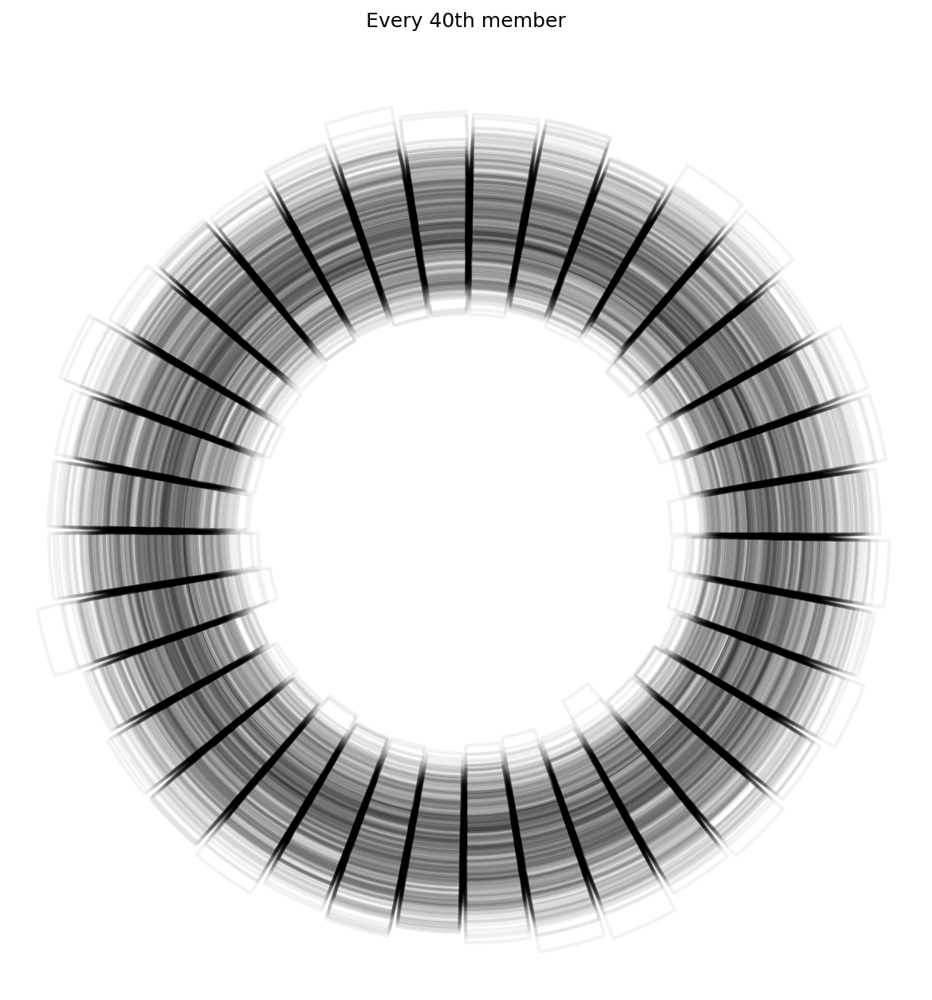

In [57]:
plt.figure(figsize=(10, 10), dpi=150)
axes = plt.subplot(111, polar=True)

X_to_plot = .1 * X[:, ::40]
X_to_plot = np.repeat(X_to_plot, N_YpX, axis=0)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '-k', linewidth=2, alpha=0.05)
plt.yticks([0])
plt.ylim([-2.5, 1.5])
axes.set_yticklabels([])
plt.xticks([])
axes.spines['polar'].set_visible(False)
plt.title('Every 40th member')

Text(0.5,1.05,'Coarse Ensemble')

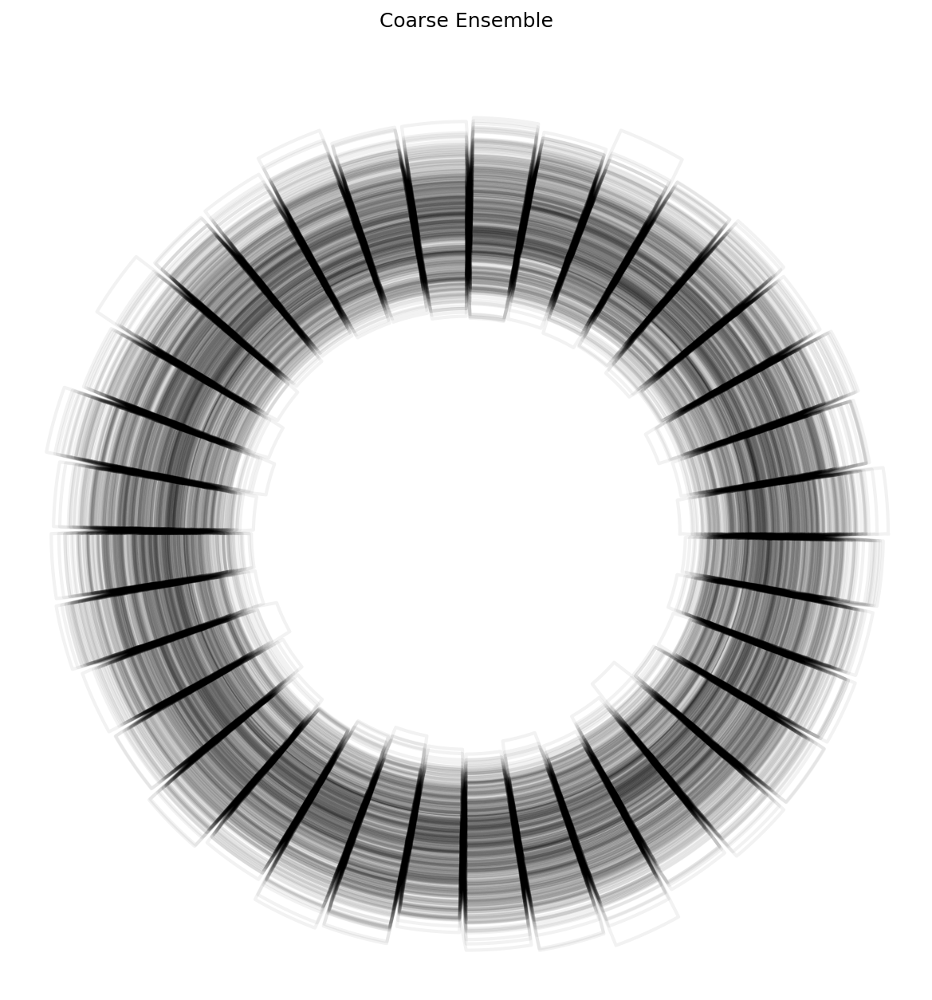

In [58]:
plt.figure(figsize=(10, 10), dpi=150)
axes = plt.subplot(111, polar=True)

X_to_plot = .1 * X_ens
X_to_plot = np.repeat(X_to_plot, N_YpX, axis=0)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '-k', linewidth=2, alpha=0.05)
plt.yticks([0])
plt.ylim([-2.5, 1.5])
axes.set_yticklabels([])
plt.xticks([])
axes.spines['polar'].set_visible(False)
plt.title('Coarse Ensemble')

In [62]:
XY_ens_mean = XY_ens.mean(axis=1)
XY_ens_sd = np.std(XY_ens, axis=1)
X_ens_mean = X_ens.mean(axis=1)
X_ens_sd = np.std(X_ens, axis=1)

Text(0.5,1.05,'Standard deviation')

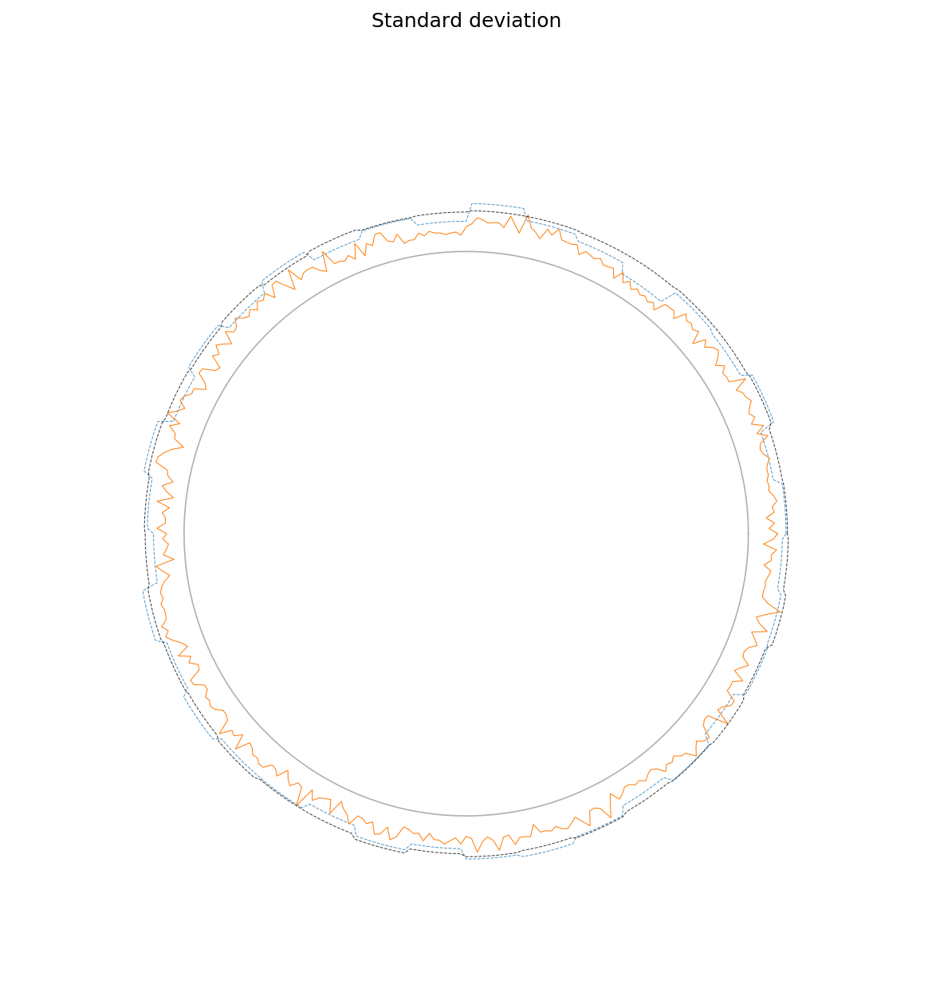

In [64]:
plt.figure(figsize=(10, 10), dpi=150)
axes = plt.subplot(111, polar=True)

X_to_plot = .1 * XY_ens_sd[:N_X]
X_to_plot = np.repeat(X_to_plot, N_YpX)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '--', linewidth=0.5, alpha=0.75)


Y_to_plot = XY_ens_sd[N_X:]
Y_to_plot = np.concatenate([Y_to_plot, 
                            [Y_to_plot[0]]])
plt.polar(theta_Y, Y_to_plot, linewidth=0.5)

X_to_plot = .1 * X_ens_sd
X_to_plot = np.repeat(X_to_plot, N_YpX)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '--k', linewidth=0.5, alpha=0.75)

plt.yticks([0])
plt.ylim([-2.5, 1.5])
axes.set_yticklabels([])
plt.xticks([])
axes.spines['polar'].set_visible(False)
plt.title('Standard deviation')

Text(0.5,1.05,'mean')

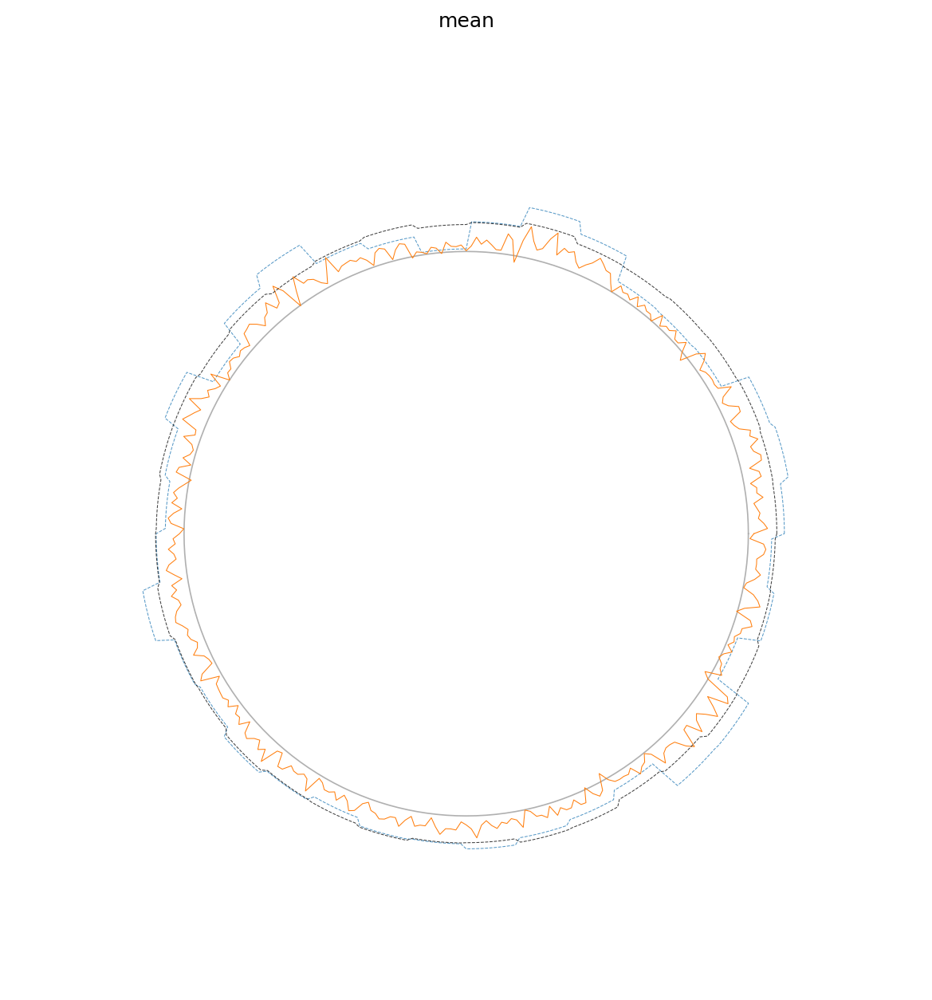

In [65]:
plt.figure(figsize=(10, 10), dpi=150)
axes = plt.subplot(111, polar=True)

X_to_plot = .1 * XY_ens_mean[:N_X]
X_to_plot = np.repeat(X_to_plot, N_YpX)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '--', linewidth=0.5, alpha=0.75)


Y_to_plot = XY_ens_mean[N_X:]
Y_to_plot = np.concatenate([Y_to_plot, 
                            [Y_to_plot[0]]])
plt.polar(theta_Y, Y_to_plot, linewidth=0.5)

X_to_plot = .1 * X_ens_mean
X_to_plot = np.repeat(X_to_plot, N_YpX)
X_to_plot = np.concatenate([X_to_plot,
                            [X_to_plot[0]]])
plt.polar(theta_Y, X_to_plot, '--k', linewidth=0.5, alpha=0.75)

plt.yticks([0])
plt.ylim([-2.5, 1.5])
axes.set_yticklabels([])
plt.xticks([])
axes.spines['polar'].set_visible(False)
plt.title('mean')

In [121]:
def L96_multi_ensemble(XY_ens, X_ens, F=8, c=10, b=10, h=1):
    """
    
    """
    N_XY, N_eXY = XY_ens.shape
    N_X, N_eX = X_ens.shape
    N_Y = N_XY - N_X
    N_YpX = N_Y // N_X
    if N_X * N_YpX != N_Y:
        raise Exception('Size of X should evenly divide size of Y.')
    XfY_ens = XY_ens[:N_X]
    Y_ens = XY_ens[N_X:]
    
    Y_sum = Y_ens.reshape(N_X, N_YpX, N_eXY).sum(axis=1)

    Xp1 = np.roll(XfY_ens, -1, axis=0)
    Xm2 = np.roll(XfY_ens, 2, axis=0)
    Xm1 = np.roll(XfY_ens, 1, axis=0)
    dXfYdt = (Xp1 - Xm2) * Xm1 - XfY_ens + F - (h * c) / b * Y_sum
    
    X_forcing =  np.repeat(XfY_ens, N_YpX, axis=0)
    Ym1 = np.roll(Y_ens, 1, axis=0)
    Yp2 = np.roll(Y_ens, -2, axis=0)
    Yp1 = np.roll(Y_ens, -1, axis=0)
    dYdt = (c * b) * (Ym1 - Yp2) * Yp1 - c*Y_ens + (h*c)/b*X_forcing
    
    dXYdt = np.concatenate([dXfYdt, dYdt],
                           axis=0)
    
    repeats = N_eX / N_eXY
    if repeats != int(repeats):
        raise Exception('Ensemble size of X should evenly divide ensemble size of Y.')
    repeats = int(repeats)
    Y_sum = np.repeat(Y_sum, repeats, axis=1)
    
    Xp1 = np.roll(X_ens, -1, axis=0)
    Xm2 = np.roll(X_ens, 2, axis=0)
    Xm1 = np.roll(X_ens, 1, axis=0)
    dXdt = (Xp1 - Xm2) * Xm1 - X_ens + F - (h * c) / b * Y_sum
    
    return dXYdt, dXdt

In [152]:
def return_L96_multi_ens_data(XY0_ens, X0_ens, t, F=8, b=10, c=10, h=1):
    N_XY, N_eXY = XY0_ens.shape
    N_X, N_eX = X0_ens.shape
    N_Y = N_XY - N_X
    N_YpX = N_Y // N_X
    if N_X * N_YpX != N_Y:
        raise Exception('Size of X should evenly divide size of Y.')
    XY_ens_size = N_XY * N_eXY
    N_t = t.size
    def this_L96_multi_ens(XYX_raveled, t):
        XY_ens = XYX_raveled[:XY_ens_size].reshape(N_XY, N_eXY)
        X_ens = XYX_raveled[XY_ens_size:].reshape(N_X, N_eX)
        dXYdt, dXdt = L96_multi_ensemble(
            XY_ens, X_ens, F=F, b=b, c=c, h=h)
        to_return = np.concatenate(
            [dXYdt.ravel(), dXdt.ravel()])
        return to_return
    XY0_raveled = np.concatenate(
        [XY0_ens.ravel(), X0_ens.ravel()])
    XYX_raveled = integrate.odeint(
        this_L96_multi_ens, XY0_raveled, t)
    XYX_raveled = XYX_raveled.T
    XY_ens_ts = XYX_raveled[:XY_ens_size].reshape(N_XY, N_eXY, N_t)
    X_ens_ts = XYX_raveled[XY_ens_size:].reshape(N_X, N_eX, N_t)
    return XY_ens_ts, X_ens_ts

In [148]:
XY0_ens = XY_ens.copy()
X0_ens = X_ens.copy()

In [149]:
T = 1
dt = 0.05
N_t = int(T/dt + 1)
t = np.linspace(0, T, N_t)

# Test function to push forward ensemble

In [153]:
XY_ens_ts, X_ens_ts = return_L96_multi_ens_data(XY0_ens, X0_ens, t)

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


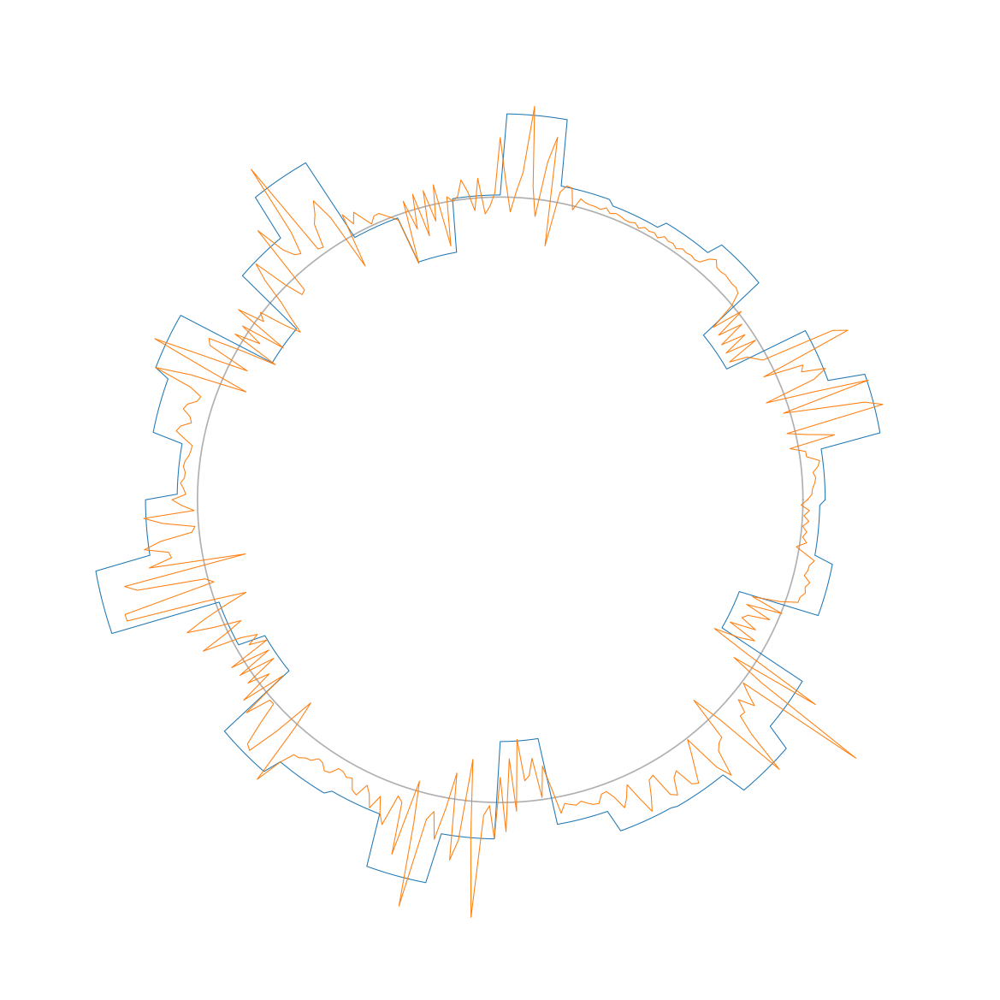

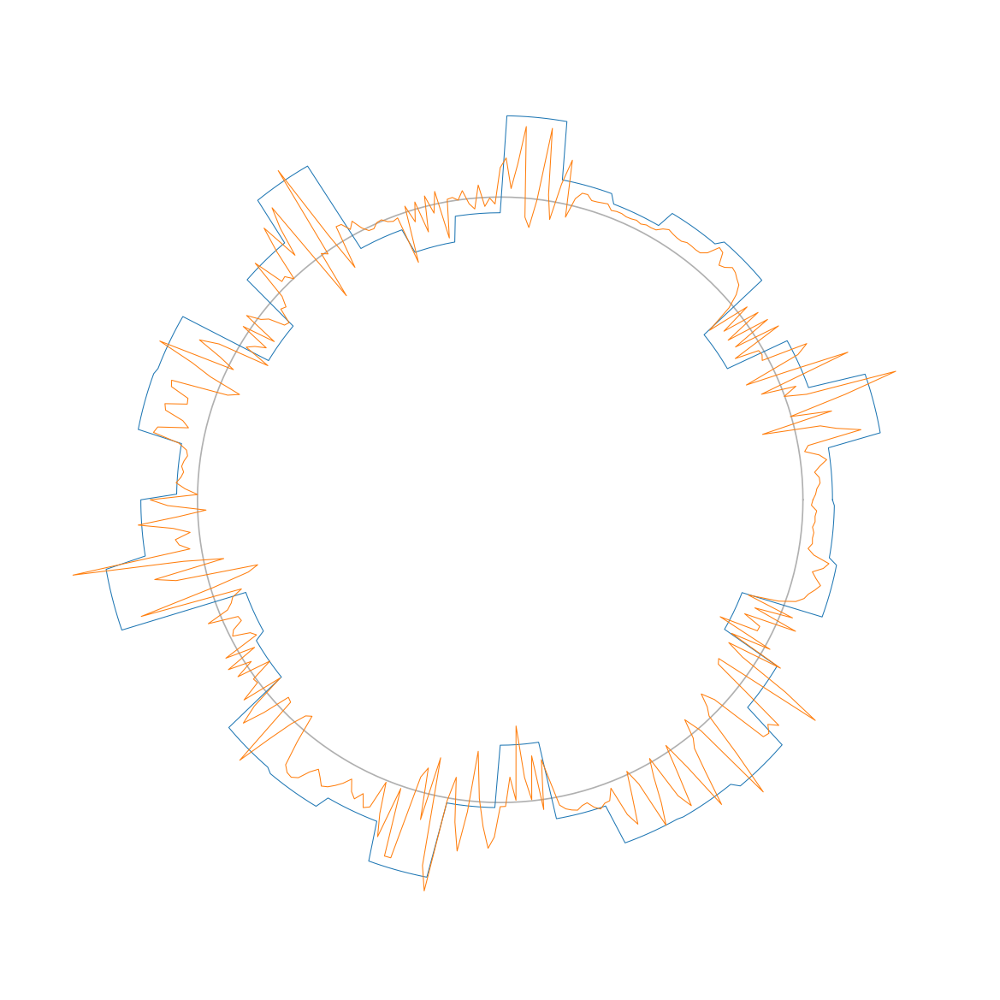

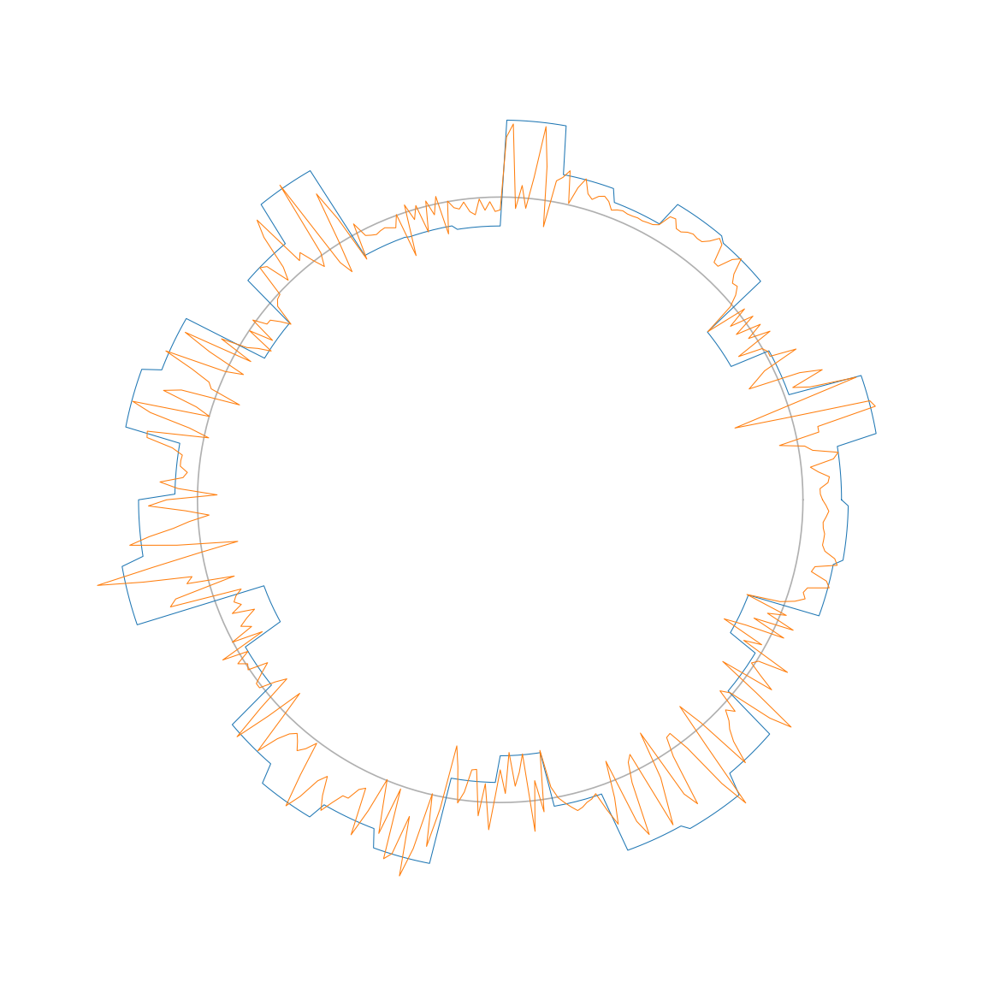

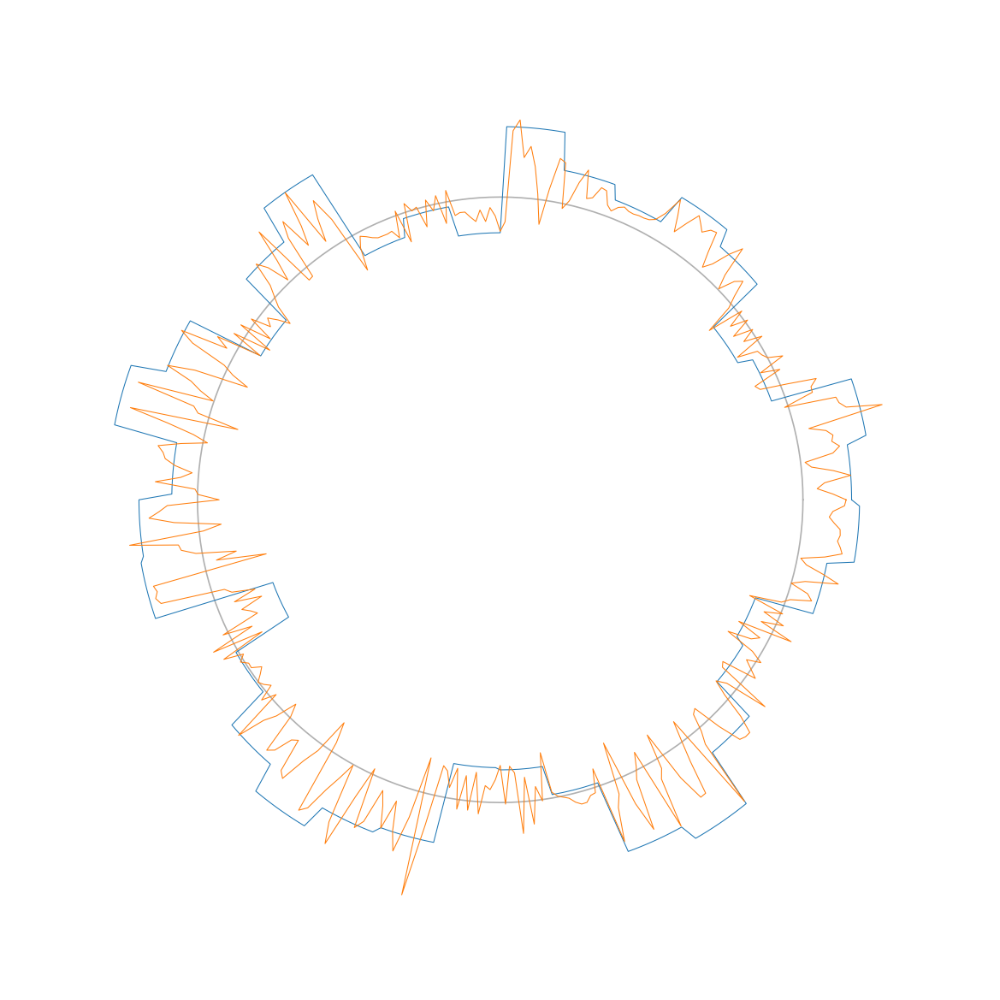

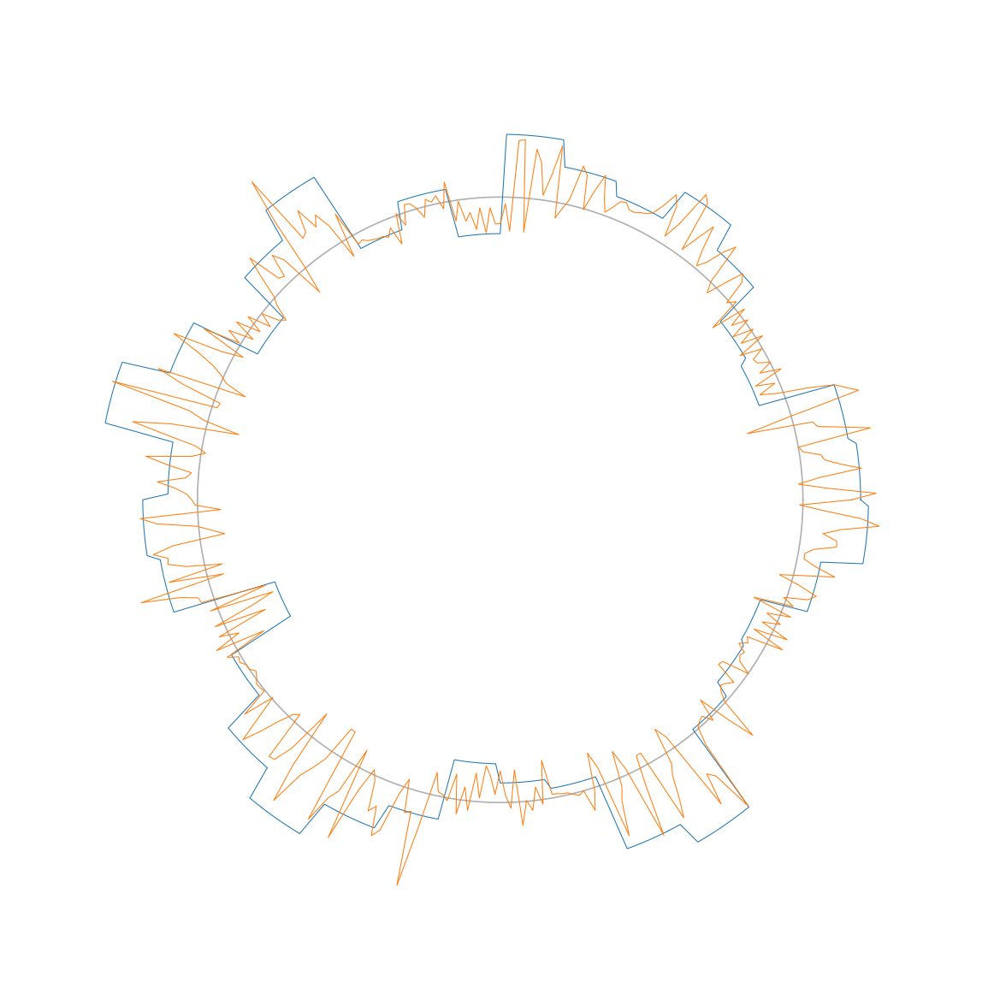

...

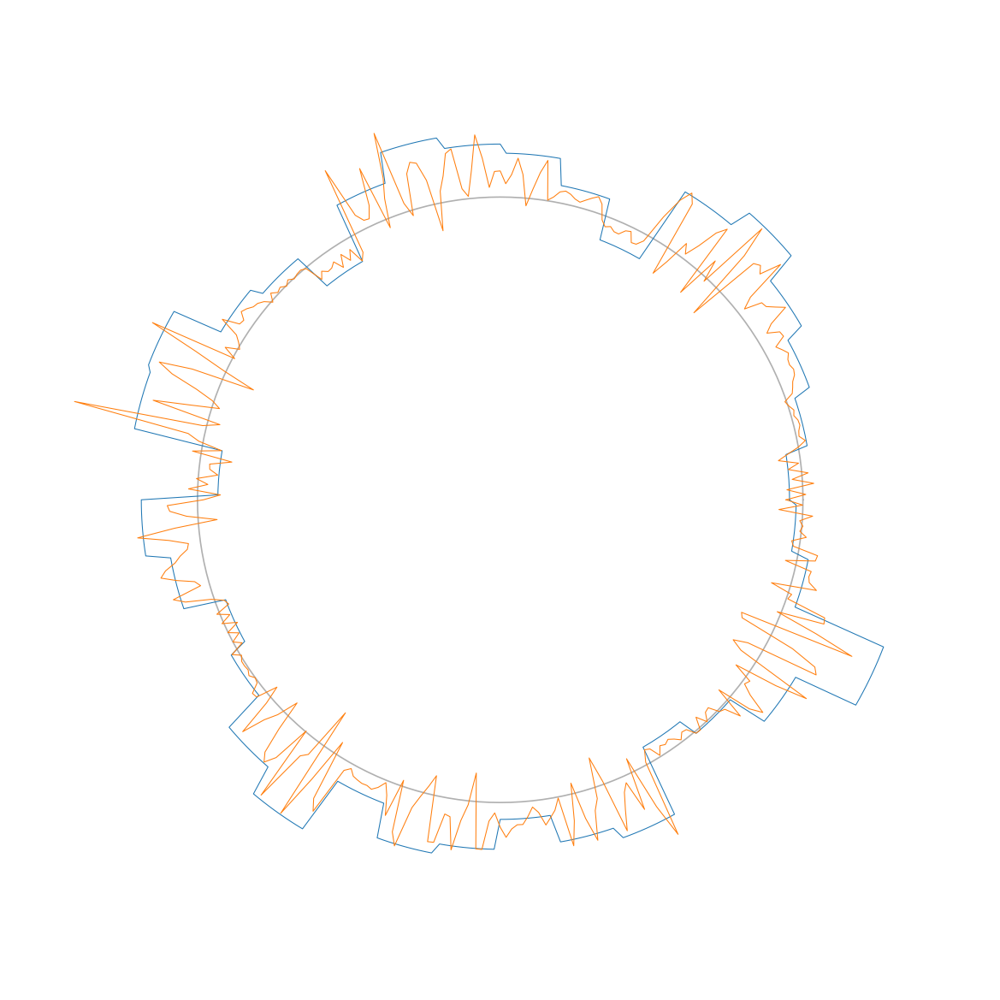

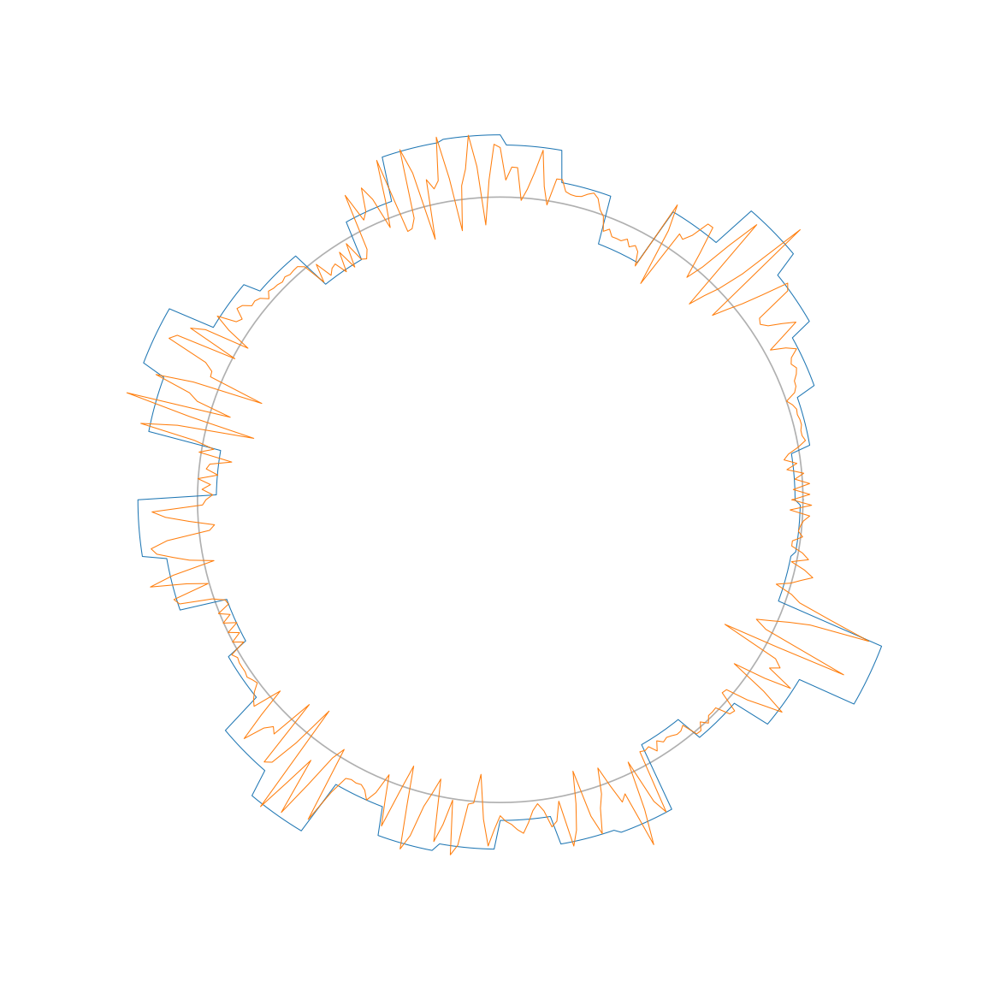

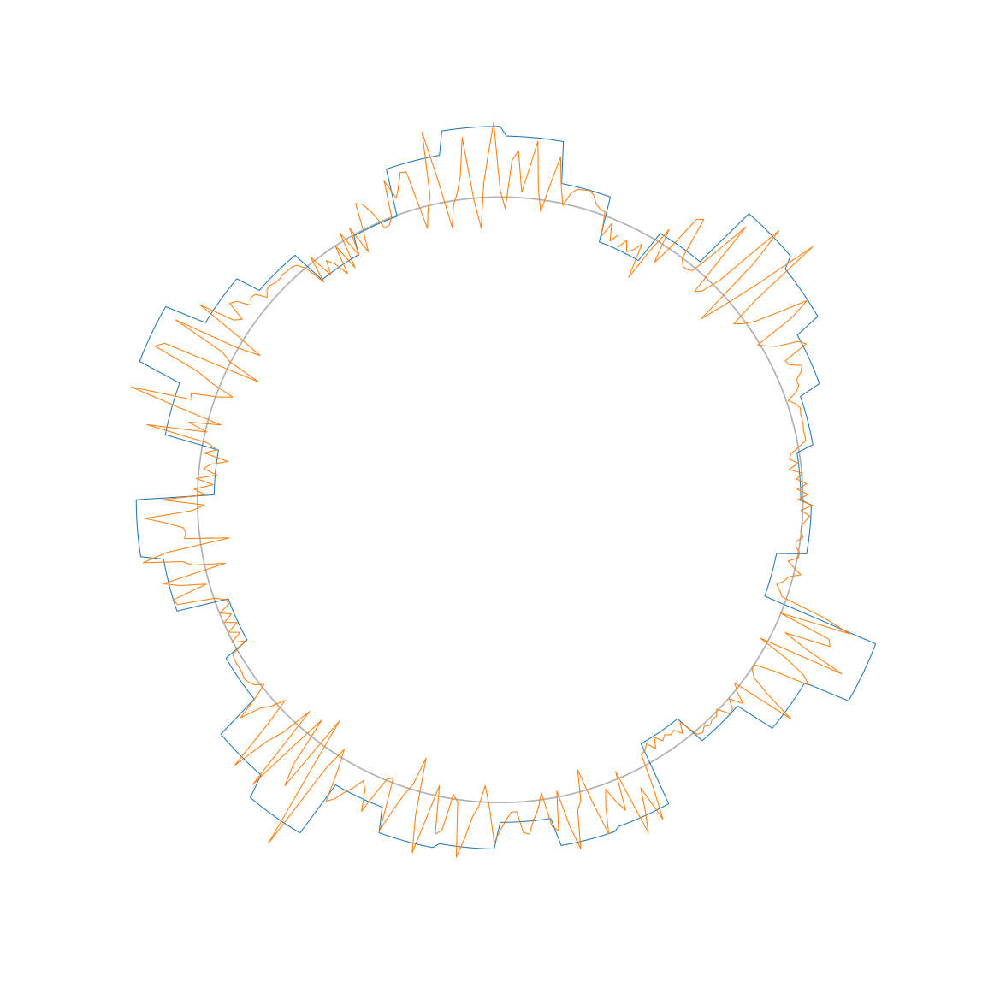

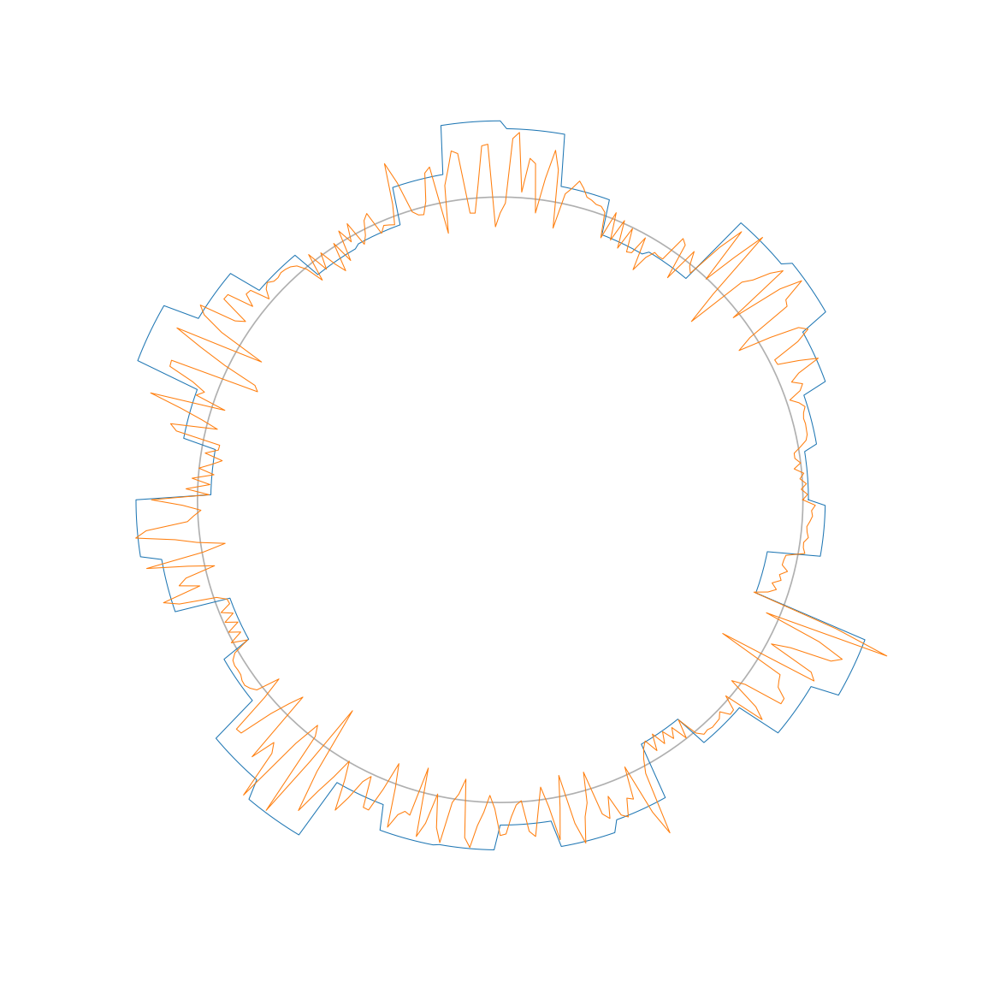

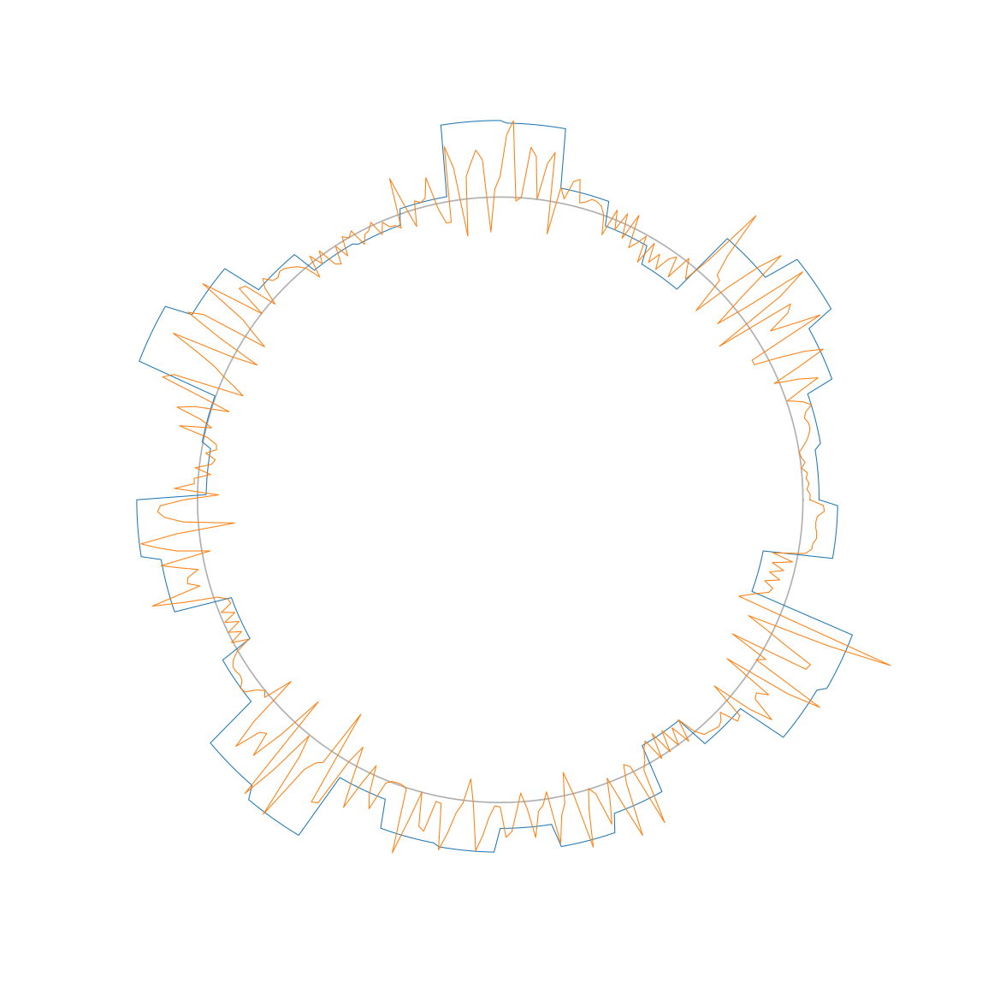

In [169]:
kk = 0
for tt in range(N_t): # range(1): # 
    plt.figure(figsize=(10,10), dpi=150)
    axes = plt.subplot(111, polar=True)
    
    X_to_plot = .1 * XY_ens_ts[:N_X, kk, tt]
    X_to_plot = np.repeat(X_to_plot, N_YpX)
    X_to_plot = np.concatenate([X_to_plot,
                                [X_to_plot[0]]])
    plt.polar(theta_Y, X_to_plot, linewidth=0.5)
    
    Y_to_plot = XY_ens_ts[N_X:, kk, tt]
    Y_to_plot = np.concatenate([Y_to_plot, 
                                [Y_to_plot[0]]])
    plt.polar(theta_Y, Y_to_plot, linewidth=0.5)
    
#     for ii in range(int(N_eX/N_eXY)):
#         ii = ii + kk * N_eXY
#         X_to_plot = .1 * X_ens_ts[:, ii, tt]
#         X_to_plot = np.repeat(X_to_plot, N_YpX)
#         X_to_plot = np.concatenate([X_to_plot,
#                                     [X_to_plot[0]]])
#         plt.polar(theta_Y, X_to_plot, '--k', linewidth=0.5, alpha=0.5)

    plt.yticks([0])
    plt.ylim([-2.5, 1.5])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

# Generate Truth run

In [188]:
X0 = np.random.uniform(low=-5, high=10, size=N_X)
Y0 = np.random.uniform(low=-0.5, high=1, size=N_Y)

t = np.linspace(0, 20, 100)

X0, Y0 = return_L96_multi_data(X0, Y0, t, F=F, b=b, c=c, h=h)

X0 = X0[:, -1]
Y0 = Y0[:, -1]

In [189]:
T = 100
dt = 0.05
N_t = int(T/dt + 1)
t_GT = np.linspace(0, T, N_t)

In [190]:
X_GT, Y_GT = return_L96_multi_data(X0, Y0, t_GT, F=F, b=b, c=c, h=h)

np.save('./X_GT.npy', X_GT)
np.save('./Y_GT.npy', Y_GT)

# XY_GT = np.load('./X_GT.npy')
# XY_GT = np.load('./Y_GT.npy')

In [267]:
XY_GT = np.concatenate([X_GT, Y_GT], axis=0)

# Look at fixed ensemble

In [192]:
X_err = X_GT - X0_ens.mean(axis=1)[:, None]
XfY_err = X_GT - XY0_ens[:N_X].mean(axis=1)[:, None]
Y_err = Y_GT - XY0_ens[N_X:].mean(axis=1)[:, None]
RMSE_X = np.sqrt((X_err**2).mean(axis=0))
RMSE_XfY = np.sqrt((XfY_err**2).mean(axis=0))
RMSE_Y = np.sqrt((Y_err**2).mean(axis=0))
RMSE_XY = np.sqrt(np.concatenate([XfY_err**2, Y_err**2], axis=0).mean(axis=0))

Text(0,0.5,'RMSE')

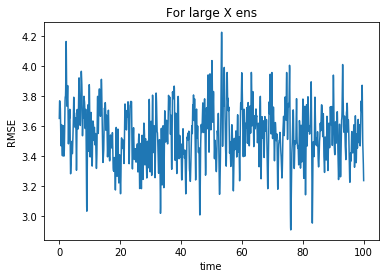

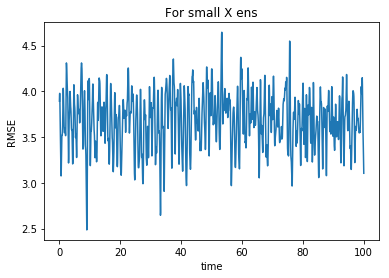

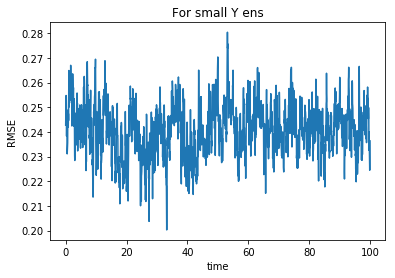

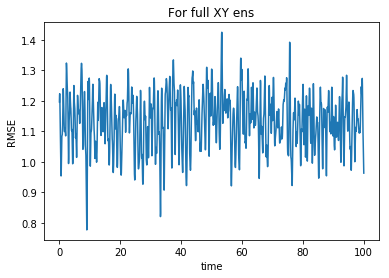

In [194]:
plt.figure()
plt.plot(t_GT, RMSE_X)
plt.title('For large X ens')
plt.xlabel('time')
plt.ylabel('RMSE')

plt.figure()
plt.plot(t_GT, RMSE_XfY)
plt.title('For small X ens')
plt.xlabel('time')
plt.ylabel('RMSE')

plt.figure()
plt.plot(t_GT, RMSE_Y)
plt.title('For small Y ens')
plt.xlabel('time')
plt.ylabel('RMSE')

plt.figure()
plt.plot(t_GT, RMSE_XY)
plt.title('For full XY ens')
plt.xlabel('time')
plt.ylabel('RMSE')

In [196]:
this = np.repeat(X_GT, 5, axis=0)
print(this[:, 10])

[-2.00483806 -2.00483806 -2.00483806 -2.00483806 -2.00483806 -0.36842462
 -0.36842462 -0.36842462 -0.36842462 -0.36842462  7.86229428  7.86229428
  7.86229428  7.86229428  7.86229428  0.75437717  0.75437717  0.75437717
  0.75437717  0.75437717 -3.08356142 -3.08356142 -3.08356142 -3.08356142
 -3.08356142  0.9236991   0.9236991   0.9236991   0.9236991   0.9236991
  2.05117031  2.05117031  2.05117031  2.05117031  2.05117031  5.66215664
  5.66215664  5.66215664  5.66215664  5.66215664  5.06496988  5.06496988
  5.06496988  5.06496988  5.06496988 -2.86852903 -2.86852903 -2.86852903
 -2.86852903 -2.86852903  4.2156783   4.2156783   4.2156783   4.2156783
  4.2156783   5.36788064  5.36788064  5.36788064  5.36788064  5.36788064
  4.92145348  4.92145348  4.92145348  4.92145348  4.92145348  4.43623732
  4.43623732  4.43623732  4.43623732  4.43623732 -2.83334099 -2.83334099
 -2.83334099 -2.83334099 -2.83334099  3.78627419  3.78627419  3.78627419
  3.78627419  3.78627419  2.50768893  2.50768893  2.5

In [199]:
Z_GT = np.repeat(X_GT, N_YpX, axis=0) + Y_GT
Z_ens_mean = np.repeat(XY0_ens[:N_X].mean(axis=1), N_YpX, axis=0) + XY0_ens[N_X:].mean(axis=1)
X_ens_mean = X0_ens.mean(axis=1)

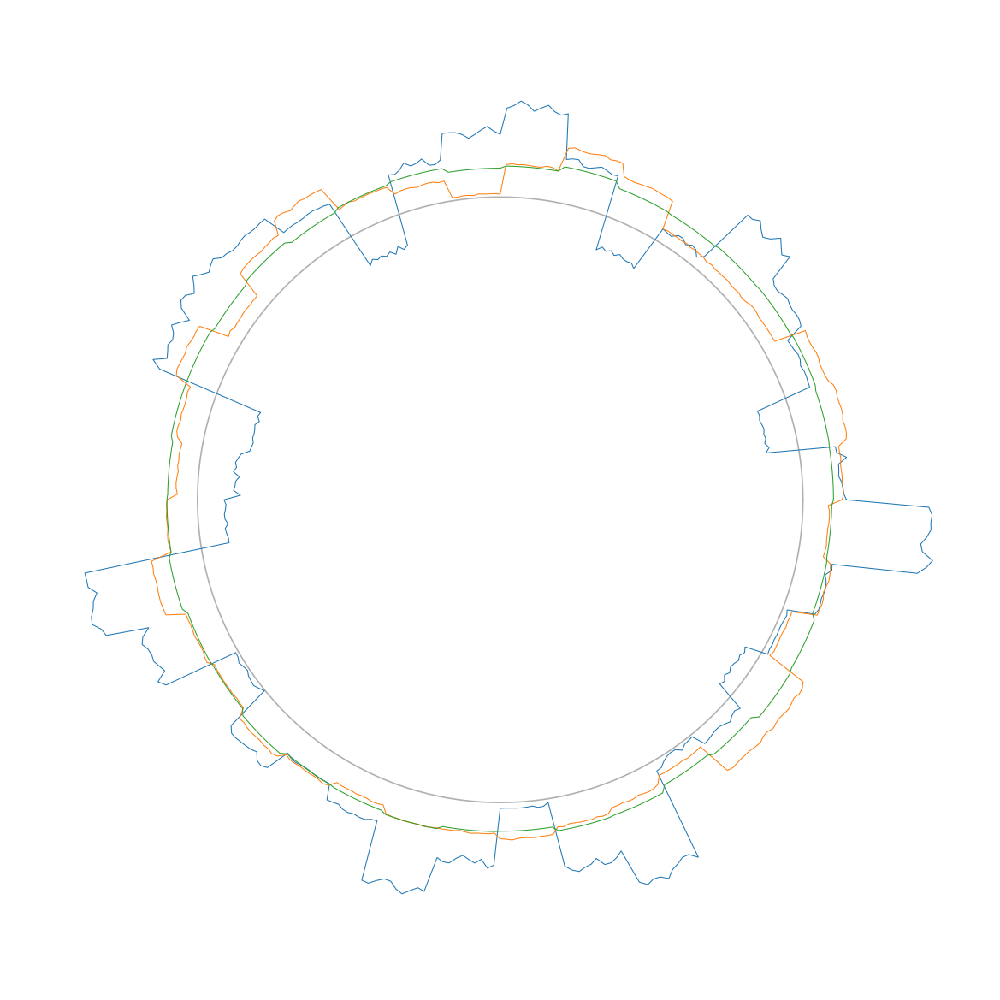

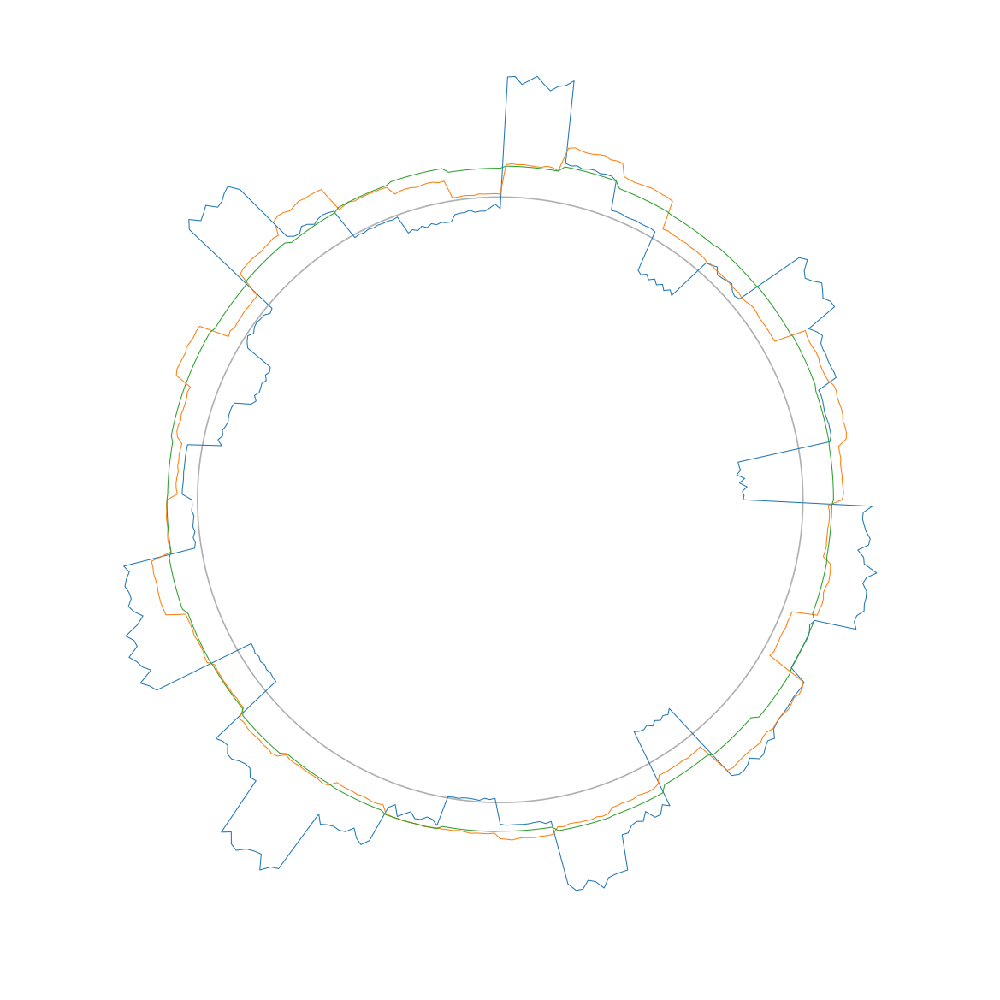

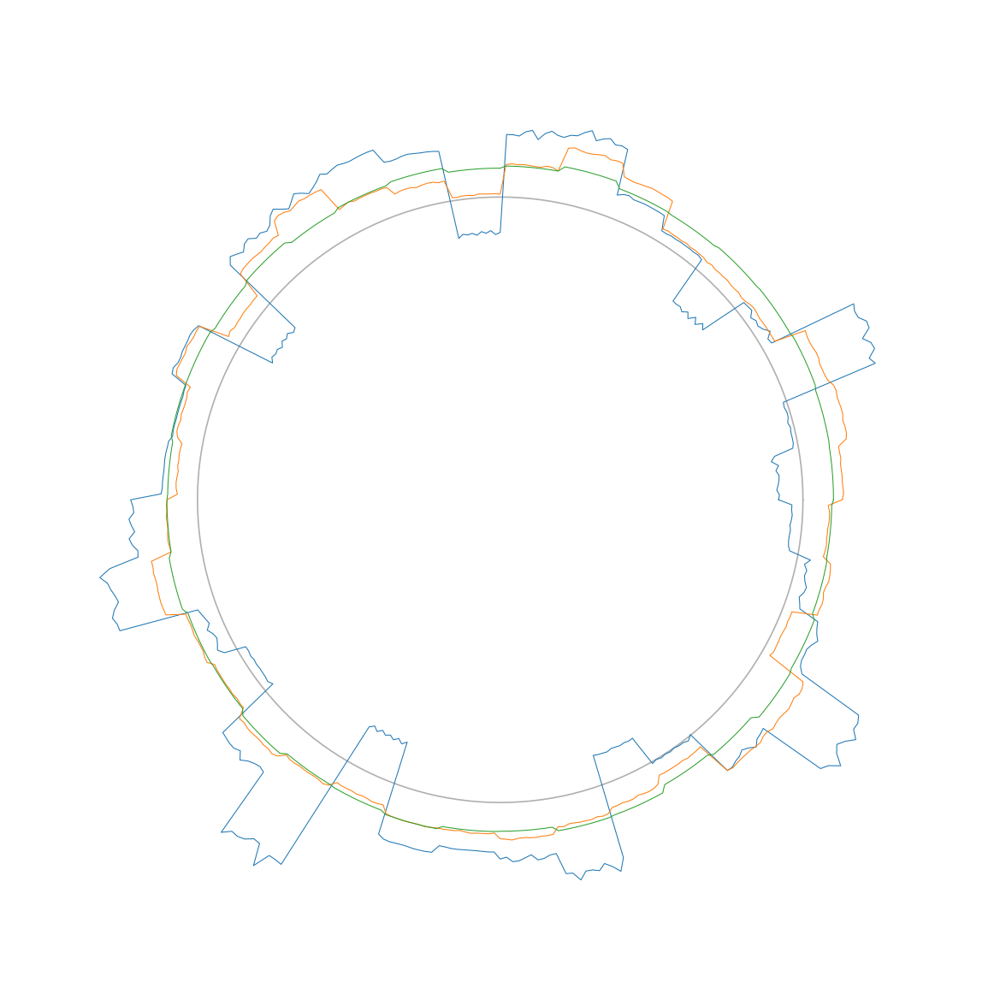

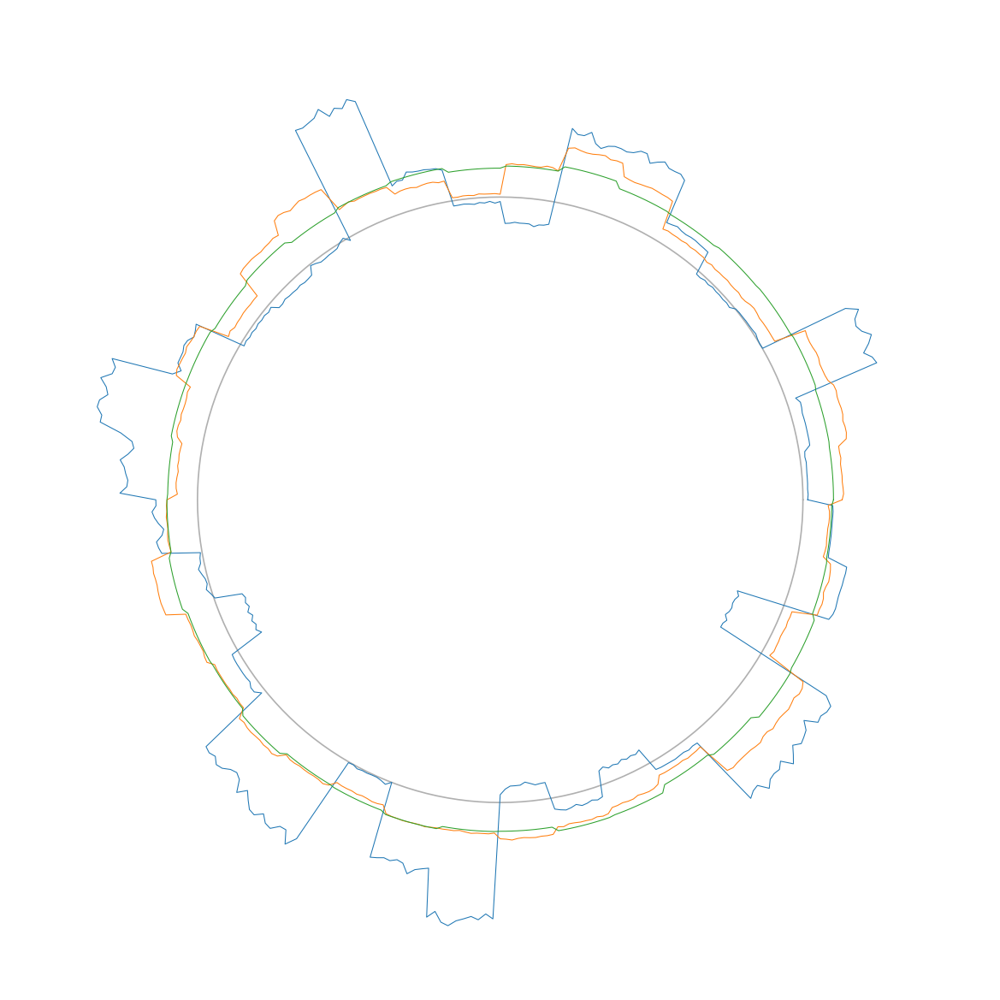

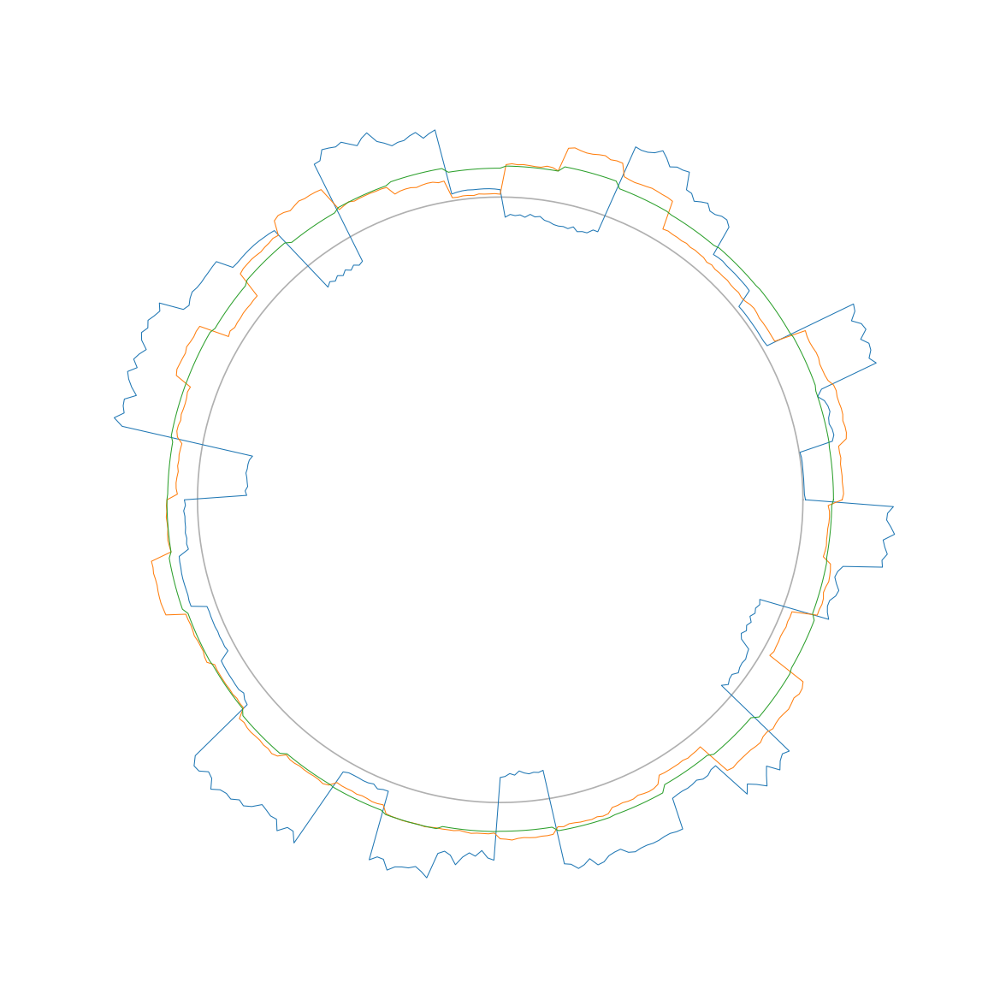

In [200]:
Z_mean_to_plot = Z_ens_mean.copy()
Z_mean_to_plot = np.concatenate([Z_mean_to_plot,
                                 [Z_mean_to_plot[0]]])

X_mean_to_plot = np.repeat(X_ens_mean, N_YpX, axis=0)
X_mean_to_plot = np.concatenate([X_mean_to_plot,
                                 [X_mean_to_plot[0]]])
for tt in range(5): #  range(N_t): #
    tt *= 5
    plt.figure(figsize=(10, 10), dpi=150)
    axes = plt.subplot(111, polar=True)
    Z_to_plot = Z_GT[:, tt]
    Z_to_plot = np.concatenate([Z_to_plot, 
                                [Z_to_plot[0]]])
    plt.polar(theta_Y, Z_to_plot, linewidth=0.5)
    plt.polar(theta_Y, Z_mean_to_plot, linewidth=0.5)
    plt.polar(theta_Y, X_mean_to_plot, linewidth=0.5)
    plt.yticks([0])
    plt.ylim([-2.5 * 10, 1.5 * 10])
    axes.set_yticklabels([])
    plt.xticks([])
    axes.spines['polar'].set_visible(False)

In [202]:
Z_err = Z_GT - Z_ens_mean[:, None]
XaZ_err = Z_GT - np.repeat(X_ens_mean, N_YpX, axis=0)[:, None]
RMSE_Z = np.sqrt((Z_err**2).mean(axis=0))
RMSE_XaZ = np.sqrt((XaZ_err**2).mean(axis=0))

Text(0,0.5,'RMSE')

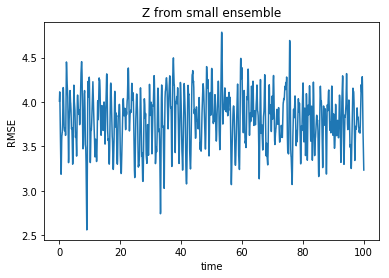

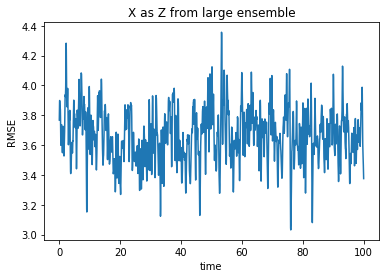

In [204]:
plt.figure()
plt.plot(t_GT, RMSE_Z)
plt.title('Z from small ensemble')
plt.xlabel('time')
plt.ylabel('RMSE')

plt.figure()
plt.plot(t_GT, RMSE_XaZ)
plt.title('X as Z from large ensemble')
plt.xlabel('time')
plt.ylabel('RMSE')

In [210]:
P_X = np.cov(X0_ens)
P_XY = np.cov(XY0_ens)
Z0_ens = np.repeat(XY0_ens[:N_X], N_YpX, axis=0) + XY0_ens[N_X:]
P_Z = np.cov(Z0_ens)

C_X = np.corrcoef(X0_ens)
C_XY = np.corrcoef(XY0_ens)
C_Z = np.corrcoef(Z0_ens)

Text(0.5,1,'Correlation Z from small ens')

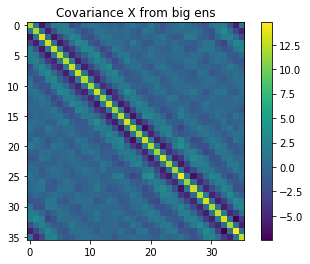

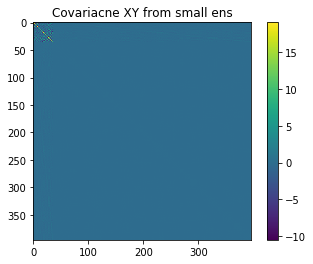

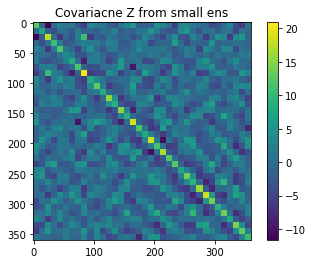

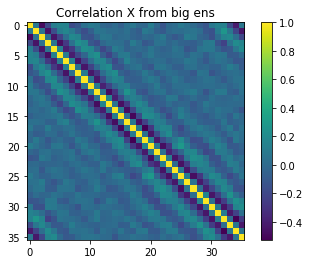

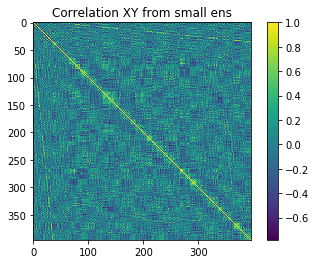

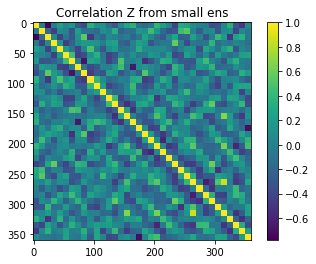

In [216]:
plt.figure()
im = plt.imshow(P_X)
plt.colorbar(im)
plt.title('Covariance X from big ens')

plt.figure()
im = plt.imshow(P_XY)
plt.colorbar(im)
plt.title('Covariacne XY from small ens')

plt.figure()
im = plt.imshow(P_Z)
plt.colorbar(im)
plt.title('Covariacne Z from small ens')


plt.figure()
im = plt.imshow(C_X)
plt.colorbar(im)
plt.title('Correlation X from big ens')

plt.figure()
im = plt.imshow(C_XY)
plt.colorbar(im)
plt.title('Correlation XY from small ens')

plt.figure()
im = plt.imshow(C_Z)
plt.colorbar(im)
plt.title('Correlation Z from small ens')\

In [272]:
P_XY_GT = np.cov(XY_GT)
C_XY_GT = np.corrcoef(XY_GT)

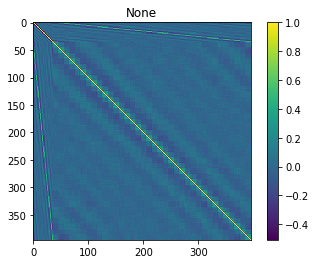

In [273]:
imshow(C_XY_GT)

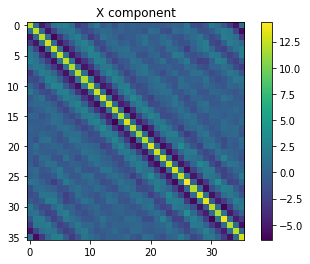

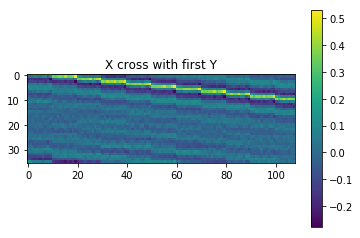

In [275]:
imshow(P_XY_GT[:N_X, :N_X], title='X component')
imshow(P_XY_GT[:N_X, N_X:4*N_X], title='X cross with first Y')

# Use large X ensemble to localize fine Z ensemble

This does not work. I can use the relationship between X and Y to localize the small Y or thr small X ensemble, but I do not know what to do with the cross correlation. I will look at Lorenz's Model III. This has only one variable, but I will need to figure out how to model this variable without the fine variable. I think it should be ok.

I could also look at refomulating this model so that the state vector is Z, but I think it will be better to just use model III.

In [221]:
Z_GT0 = Z_GT[:, 0]
P_Z = np.cov(Z0_ens)
P_X = np.cov(X0_ens)

Text(0.5,1,'Covariance of X (large ens.)')

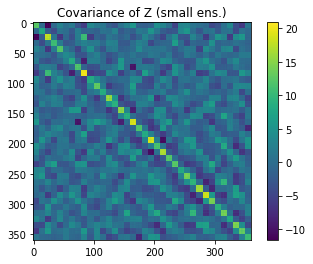

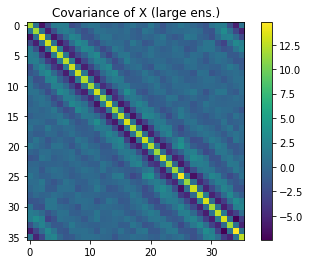

In [222]:
plt.figure()
im = plt.imshow(P_Z)
plt.colorbar(im)
plt.title('Covariance of Z (small ens.)')

plt.figure()
im = plt.imshow(P_X)
plt.colorbar(im)
plt.title('Covariance of X (large ens.)')

In [232]:
# measure every 4th Z loc; measurement error of 1
H = np.eye(N_Y)[::4]
R = np.eye(N_Y//4)

In [234]:
H_subgrid = np.eye(P_X.shape[0])
R_subgrid = 1 * np.eye(P_X.shape[0])
trans_mats = assimilate.transformation_matrices(
    H_subgrid, P=P_X,
    R=R_subgrid, return_Ts=True)

for key, val in trans_mats.items():
    key = key + '_X'
    print(key)
    exec(key + '=val')

P_sqrt_X
P_inv_sqrt_X
R_sqrt_X
R_inv_sqrt_X
U_X
S_X
VT_X
H_X
Tx_X
Tx_inv_X
Ty_X
Ty_inv_X


In [235]:
U_X_interp = np.repeat(U_X, N_YpX, axis=0)/np.sqrt(N_YpX)
VT_X_interp = np.repeat(VT_X, N_YpX, axis=1)/np.sqrt(N_YpX)

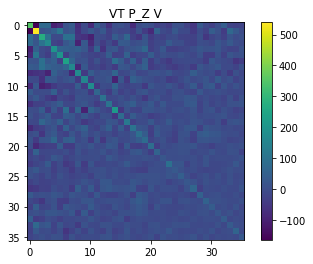

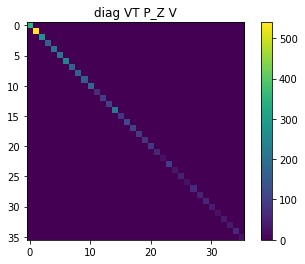

In [258]:
imshow(VT_X_interp @ P_Z @ VT_X_interp.T, title='VT P_Z V')

imshow(np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T)), title='diag VT P_Z V')

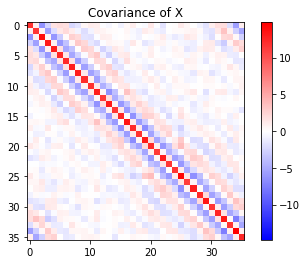

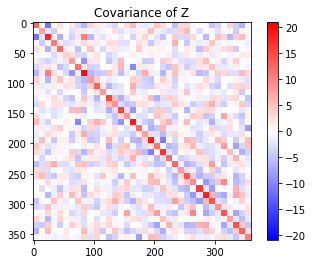

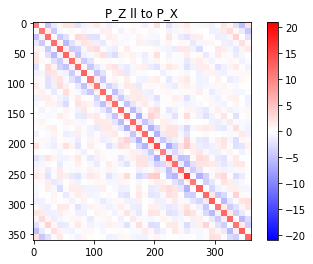

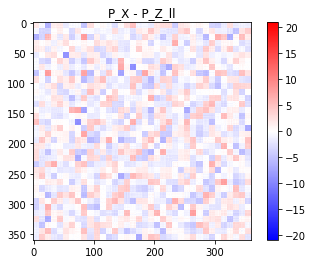

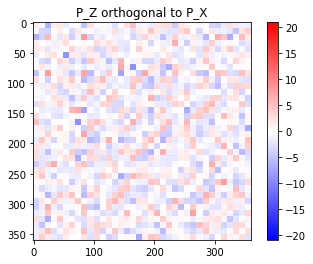

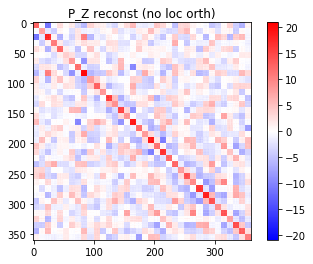

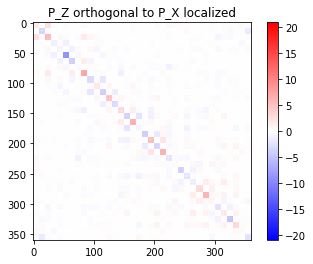

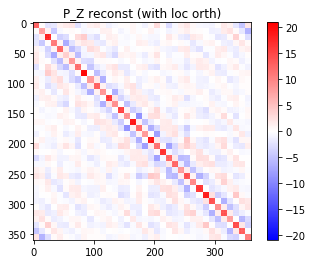

In [261]:
proj0 = VT_X_interp.T @ VT_X_interp

P_Z_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T))
        @ VT_X_interp)
# P_Z_ll_X = proj0 @ P_Z @ proj0

proj = np.eye(N_Y) - proj0

D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))

rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt

P_Z_orth_X = P_Z - P_Z_ll_X

P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X

P_Z_reconst = P_Z_ll_X + P_Z_orth_X

P_Z_reconst_loc = P_Z_ll_X + P_Z_orth_X_loc

vmax = np.max(
    [np.abs(P_Z).max(),
     np.abs(P_Z_ll_X).max(),
     np.abs(P_Z_orth_X).max(),
     np.abs(P_Z_reconst0).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax_X, vmin=-vmax_X, cmap='bwr',
       title='Covariance of X')
imshow(P_Z, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Z')
imshow(P_Z_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z ll to P_X')
# imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
#        title='P_X - P_Z_ll')
imshow(P_Z_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X')
imshow(P_Z_reconst, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (no loc orth)')
imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X localized')
imshow(P_Z_reconst_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (with loc orth)')

In [43]:
U_X_interp = np.repeat(U_X, J, axis=0)/np.sqrt(J)
VT_X_interp = np.repeat(VT_X, J, axis=1)/np.sqrt(J)

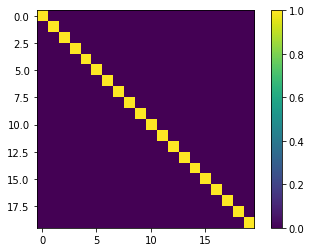

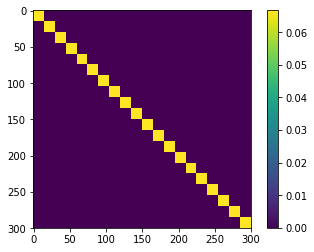

In [44]:
imshow(VT_X_interp @ VT_X_interp.T)
imshow(VT_X_interp.T @ VT_X_interp)

In [45]:
%matplotlib inline

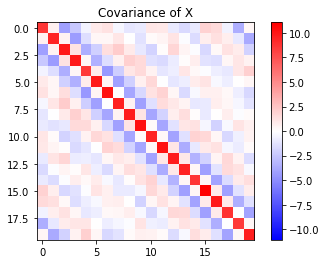

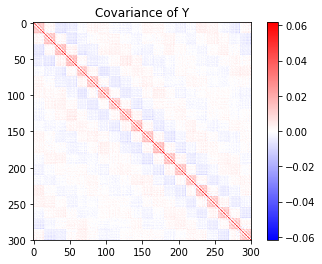

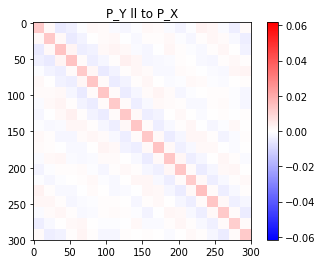

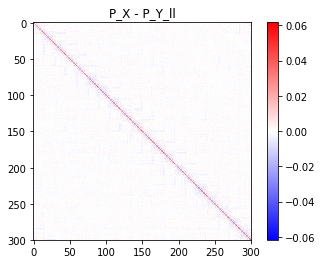

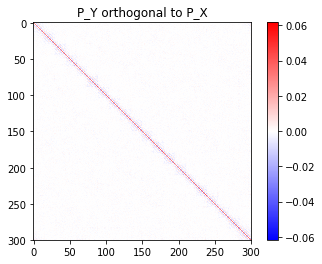

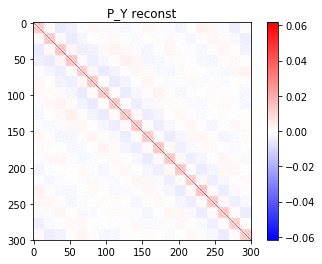

In [49]:
proj0 = VT_X_interp.T @ VT_X_interp

# P_Y_ll_X = (VT_X_interp.T
#         @ np.diag(np.diag(VT_X_interp @ P_Y @ VT_X_interp.T))
#         @ VT_X_interp)
P_Y_ll_X = proj0 @ P_Y @ proj0
# P_Y_ll_X1 = (VT_X_interp.T
#         @ VT_X_interp @ P_Y @ VT_X_interp.T
#         @ VT_X_interp)

diff = P_Y - P_Y_ll_X

# proj = np.eye(J * K) - VT_X_interp.T @ VT_X_interp
proj = np.eye(J * K) - proj0

P_Y_orth_X = proj @ P_Y @ proj

P_Y_reconst0 = P_Y_ll_X + P_Y_orth_X

vmax = np.max(
    [np.abs(P_Y).max(),
     np.abs(diff).max(),
     np.abs(P_Y_ll_X).max(),
     np.abs(P_Y_orth_X).max(),
     np.abs(P_Y_reconst0).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax_X, vmin=-vmax_X, cmap='bwr',
       title='Covariance of X')
imshow(P_Y, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Y')
imshow(P_Y_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y ll to P_X')
imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_X - P_Y_ll')
imshow(P_Y_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y orthogonal to P_X')
imshow(P_Y_reconst0, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y reconst')

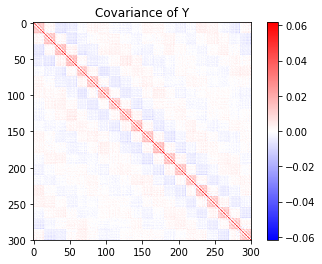

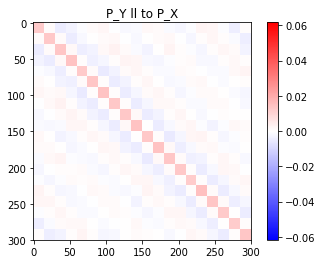

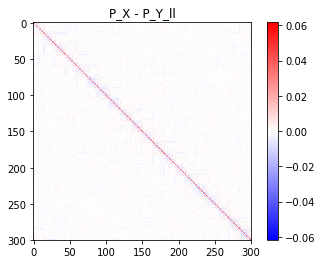

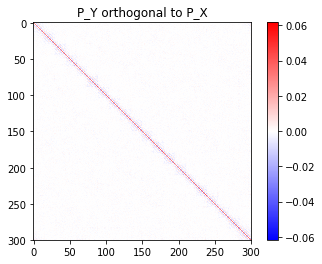

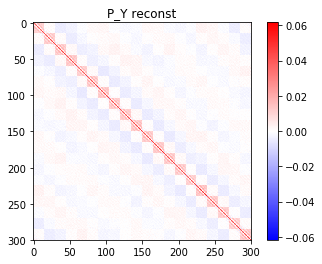

In [50]:
proj0 = VT_X_interp.T @ VT_X_interp

P_Y_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ P_Y @ VT_X_interp.T))
        @ VT_X_interp)
# P_Y_ll_X = proj0 @ P_Y @ proj0
# P_Y_ll_X1 = (VT_X_interp.T
#         @ VT_X_interp @ P_Y @ VT_X_interp.T
#         @ VT_X_interp)

diff = P_Y - P_Y_ll_X

proj = np.eye(J * K) - VT_X_interp.T @ VT_X_interp

P_Y_orth_X = proj @ P_Y @ proj

P_Y_reconst0 = P_Y_ll_X + P_Y_orth_X

vmax = np.max(
    [np.abs(P_Y).max(),
     np.abs(diff).max(),
     np.abs(P_Y_ll_X).max(),
     np.abs(P_Y_orth_X).max(),
     np.abs(P_Y_reconst0).max()])

imshow(P_Y, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Y')
imshow(P_Y_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y ll to P_X')
imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_X - P_Y_ll')
imshow(P_Y_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y orthogonal to P_X')
imshow(P_Y_reconst0, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y reconst')

In [51]:
ens_size = 20
ts = np.random.choice(t.size, size=ens_size, replace=False)
Y_sample = Y_long[:, ts]

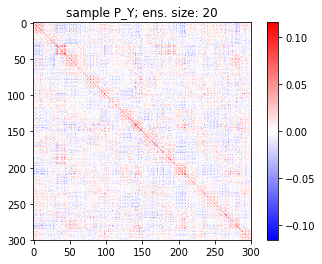

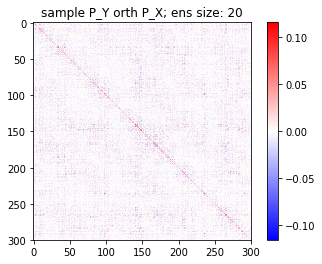

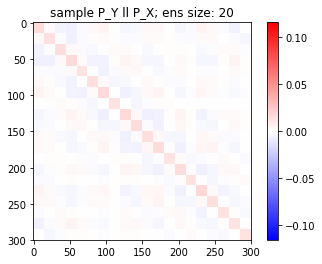

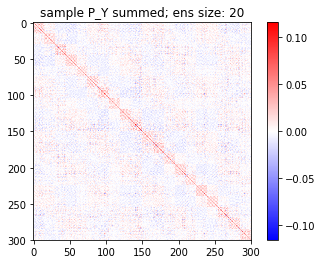

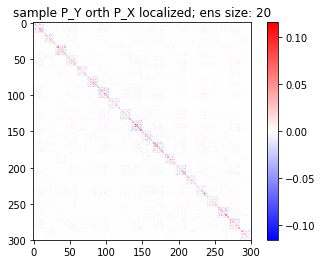

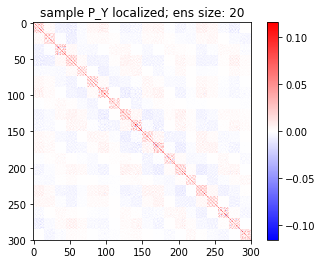

In [52]:
P_Y_sample = np.cov(Y_sample)
P_Y_sample_orth = proj @ P_Y_sample @ proj
P_Y_sample_ll = (
    VT_X_interp.T
    @ np.diag(np.diag(VT_X_interp @ P_Y_sample @ VT_X_interp.T))
    @ VT_X_interp)

# P_Y_sample_ll = (
#     VT_X_interp.T
#     @ VT_X_interp @ P_Y_sample @ VT_X_interp.T
#     @ VT_X_interp)
P_Y_sample_sum = P_Y_sample_orth + P_Y_sample_ll
D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Y_sample_ll)))
rho_Y_sample_ll = D_inv_sqrt @ P_Y_sample_ll @ D_inv_sqrt
P_Y_sample_orth_loc = rho_Y_sample_ll * P_Y_sample_orth
P_Y_sample_loc = rho_Y_sample_ll * P_Y_sample_orth + P_Y_sample_ll

vmax = np.max([
    np.abs(P_Y_sample).max(),
    np.abs(P_Y_sample_orth).max(),
    np.abs(P_Y_sample_ll).max(),
    np.abs(P_Y_sample_sum).max(),
    np.abs(P_Y_sample_loc).max(),
    np.abs(P_Y_sample_orth_loc).max()])
imshow(P_Y_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y; ens. size: {ens_size}')
imshow(P_Y_sample_orth,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y orth P_X; ens size: {ens_size}')
imshow(P_Y_sample_ll,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y ll P_X; ens size: {ens_size}')
imshow(P_Y_sample_sum,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y summed; ens size: {ens_size}')
imshow(P_Y_sample_orth_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y orth P_X localized; ens size: {ens_size}')
imshow(P_Y_sample_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample P_Y localized; ens size: {ens_size}')

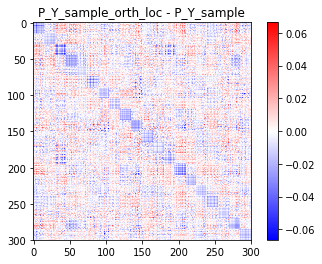

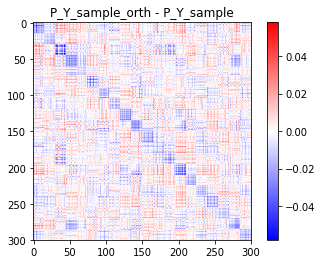

In [53]:
this_diff = P_Y_sample_orth_loc - P_Y_sample
vmax = np.abs(this_diff).max()
imshow(this_diff,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y_sample_orth_loc - P_Y_sample')

this_diff = P_Y_sample_orth - P_Y_sample
vmax = np.abs(this_diff).max()
imshow(this_diff,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y_sample_orth - P_Y_sample')

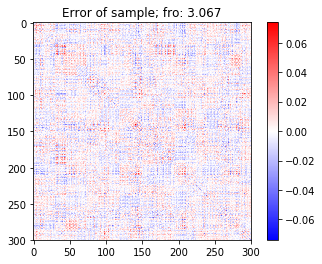

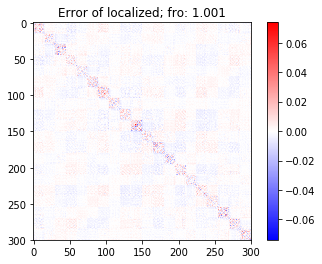

In [54]:
error_sample = P_Y_sample - P_Y
fro_sample = np.round(
    np.linalg.norm(error_sample, ord='fro'),
    decimals=3)
error_localized = P_Y_sample_loc - P_Y
fro_localized = np.round(
    np.linalg.norm(error_localized, ord='fro'),
    decimals=3)
vmax = np.max([
    np.abs(error_sample).max(),
    np.abs(error_localized).max()
])
imshow(error_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of sample; fro: {fro_sample}')
imshow(error_localized,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of localized; fro: {fro_localized}')

In [55]:
def D_KL(P, Q):
    Q_inv = np.linalg.inv(Q)
    tr = np.trace(Q_inv @ P)
    k = np.shape(P)[0]
    Q_det = np.linalg.det(Q)
    P_det = np.linalg.det(P)
    KL = tr - k + np.log(Q_det/P_det)
    return KL

In [56]:
def loc_error(P, P_sample, rho0, norm='fro'):
    [loc] = covariance.generate_circulant(
        J * K, 1.0, rho0, covariance.fft_sqd_exp_1d,
        return_Corr=True, return_sort_ind=False, return_eig=False)
    P_loc = P_sample * loc
    error = P_loc - P
    error = np.linalg.norm(error, ord=norm)
    return error, P_loc

Text(0.5, 1.0, 'Error (2) vs. rho')

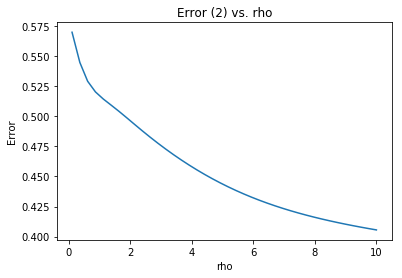

In [57]:
norm = 2
rho_array = np.linspace(.1, 10, 40)
error_array = np.ones_like(rho_array) * np.nan
for count, rho0 in enumerate(rho_array):
    error_array[count], P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0, norm=norm)
    
plt.figure()
plt.plot(rho_array, error_array)
plt.ylabel('Error')
plt.xlabel('rho')
plt.title(f'Error ({norm}) vs. rho')

Text(0.5, 1.0, 'Error (fro) vs. rho')

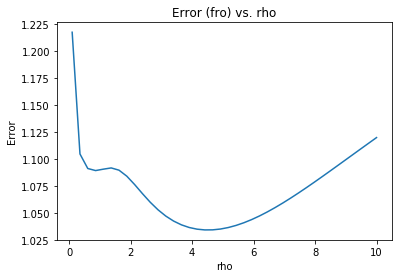

In [58]:
norm = 'fro'
rho_array = np.linspace(.1, 10, 40)
error_array = np.ones_like(rho_array) * np.nan
for count, rho0 in enumerate(rho_array):
    error_array[count], P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0, norm=norm)
    
plt.figure()
plt.plot(rho_array, error_array)
plt.ylabel('Error')
plt.xlabel('rho')
plt.title(f'Error ({norm}) vs. rho')

In [59]:
rho0 = rho_array[np.argmin(error_array)]
err, P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0)

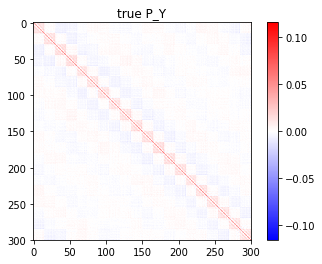

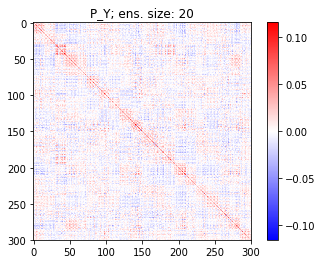

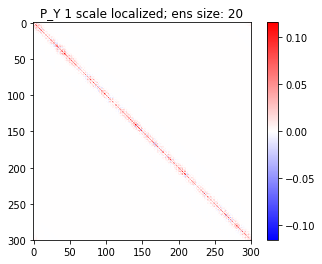

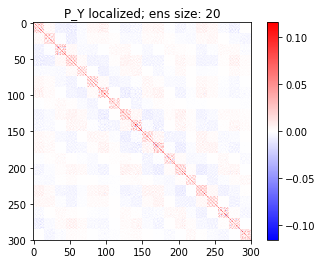

In [60]:
# Plot of Covarainces
vmax = np.max([
    np.abs(P_Y).max(),
    np.abs(P_Y_sample).max(),
    np.abs(P_Y_1_loc).max(),
    np.abs(P_Y_sample_loc).max()])
imshow(P_Y,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'true P_Y')
imshow(P_Y_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y; ens. size: {ens_size}')
imshow(P_Y_1_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y 1 scale localized; ens size: {ens_size}')
imshow(P_Y_sample_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y localized; ens size: {ens_size}')

Text(0.5, 1.0, 'Variance of system')

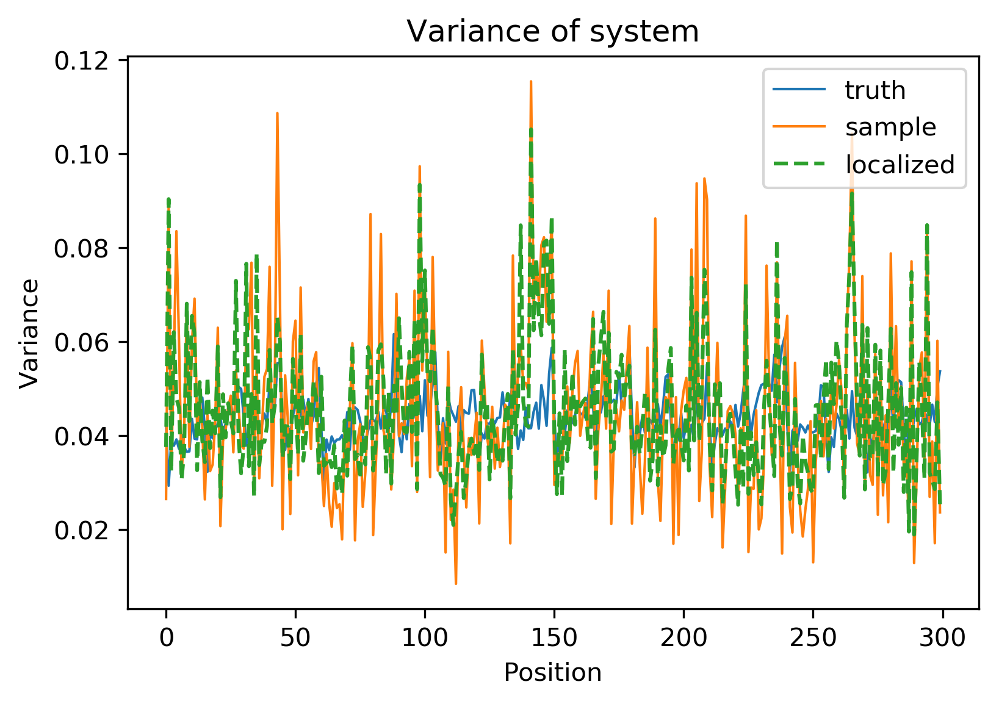

In [61]:
plt.figure(dpi=300)
plt.plot(P_Y.diagonal(), linewidth=1)
plt.plot(P_Y_sample.diagonal(), linewidth=1)
plt.plot(P_Y_sample_loc.diagonal(), linestyle='--')
plt.legend(['truth',
            'sample',
            'localized',
            '1 scale loc'])
plt.xlabel('Position')
plt.ylabel('Variance')
plt.title('Variance of system')

In [62]:
error_1_loc = P_Y_1_loc - P_Y
fro_1_loc = np.round(
    np.linalg.norm(error_1_loc, ord='fro'),
    decimals=3)

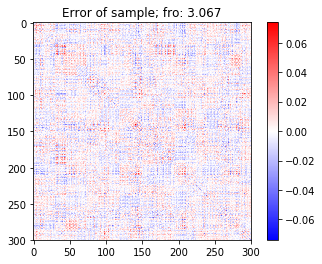

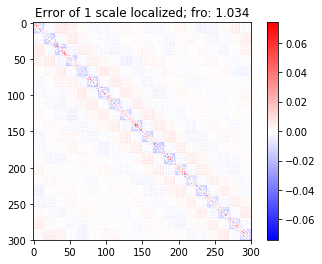

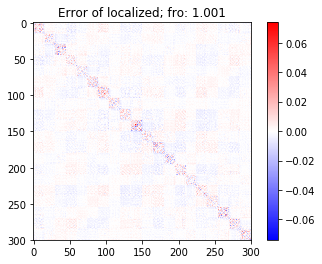

In [63]:
vmax = np.max([
    np.abs(error_sample).max(),
    np.abs(error_localized).max(),
    np.abs(error_1_loc).max()
])
imshow(error_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of sample; fro: {fro_sample}')
imshow(error_1_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of 1 scale localized; fro: {fro_1_loc}')
imshow(error_localized,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of localized; fro: {fro_localized}')

In [382]:
fro_localized = np.round(
    np.linalg.norm(error_localized, ord=2),
    decimals=3)
fro_1_loc = np.round(
    np.linalg.norm(error_1_loc, ord='fro'),
    decimals=3)
print(f'multi_loc error, frobenius norm: {fro_localized}')
print(f'one scale error, frobenius norm: {fro_1_loc}')

multi_loc error, frobenius norm: 0.264
one scale error, frobenius norm: 0.566


# Correlation not covariance

In [361]:
C_X = np.corrcoef(X_long)
C_Y = np.corrcoef(Y_long)

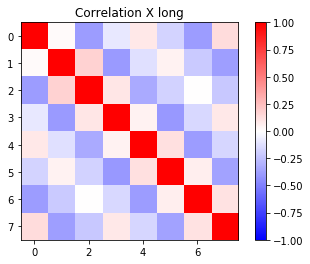

In [356]:
vmax = np.abs(C_X).max()
imshow(C_X,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Correlation X long')

In [357]:
H_subgrid = np.eye(P_X.shape[0])
R_subgrid = 1 * np.eye(P_X.shape[0])
trans_mats = assimilate.transformation_matrices(
    H_subgrid, P=C_X,
    R=R_subgrid, return_Ts=True)

for key, val in trans_mats.items():
    key = key + '_X'
    print(key)
    exec(key + '=val')

P_sqrt_X
P_inv_sqrt_X
R_sqrt_X
R_inv_sqrt_X
U_X
S_X
VT_X
H_X
Tx_X
Tx_inv_X
Ty_X
Ty_inv_X


In [358]:
U_X_interp = np.repeat(U_X, J, axis=0)/np.sqrt(J)
VT_X_interp = np.repeat(VT_X, J, axis=1)/np.sqrt(J)

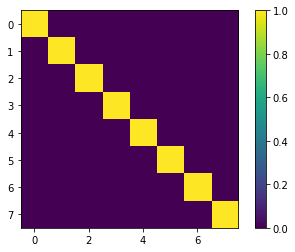

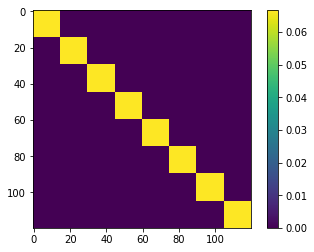

In [359]:
imshow(VT_X_interp @ VT_X_interp.T)
imshow(VT_X_interp.T @ VT_X_interp)

Text(0.5, 1.0, 'Sum of Diagonals')

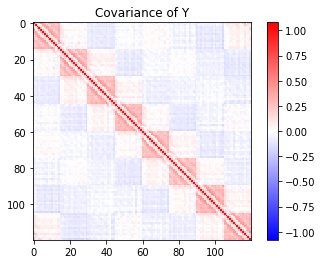

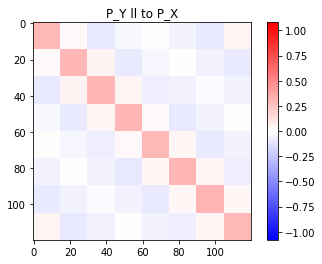

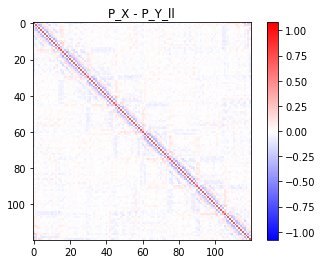

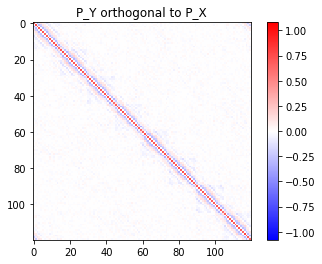

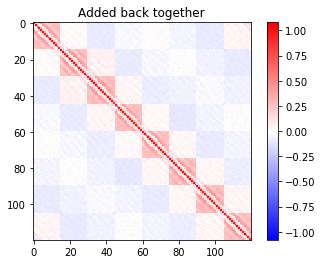

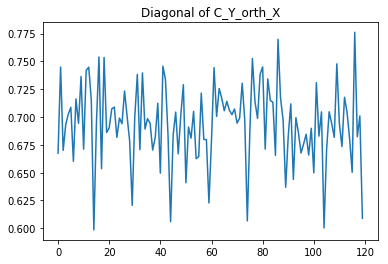

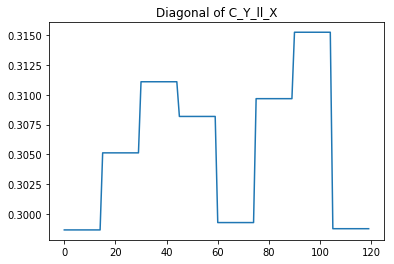

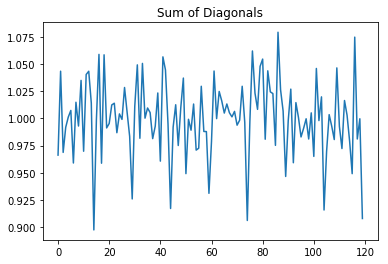

In [396]:
C_Y_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ C_Y @ VT_X_interp.T))
        @ VT_X_interp)
# C_Y_ll_X = (VT_X_interp.T
#         @ VT_X_interp @ C_Y @ VT_X_interp.T
#         @ VT_X_interp)
diff = C_Y - C_Y_ll_X

proj = np.eye(J * K) - VT_X_interp.T @ VT_X_interp

C_Y_orth_X = proj @ C_Y @ proj

C_Y_sum = C_Y_ll_X + C_Y_orth_X

vmax = np.max(
    [np.abs(C_Y).max(),
     np.abs(diff).max(),
     np.abs(C_Y_ll_X).max(),
     np.abs(C_Y_orth_X).max(),
     np.abs(C_Y_sum).max()])

imshow(C_Y, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Y')
imshow(C_Y_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y ll to P_X')
imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_X - P_Y_ll')
imshow(C_Y_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y orthogonal to P_X')
imshow(C_Y_sum, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Added back together')

plt.figure()
plt.plot(np.diag(C_Y_orth_X))
plt.title('Diagonal of C_Y_orth_X')

plt.figure()
plt.plot(np.diag(C_Y_ll_X))
plt.title('Diagonal of C_Y_ll_X')

plt.figure()
plt.plot(np.diag(C_Y_sum))
plt.title('Sum of Diagonals')

In [415]:
ens_size = 20
ts = np.random.choice(t.size, size=ens_size, replace=False)

Y_sample = Y_long[:, ts]

In [399]:
print(np.abs(C_Y_sample).max())
print(np.abs(C_Y_sample_orth).max())
print(np.abs(C_Y_sample_ll).max())
print(np.abs(C_Y_sample_sum).max())
print(np.abs(C_Y_sample_loc).max())
print(np.abs(C_Y_sample_orth_loc).max())

1.0
1.2153685891306771
0.39250094283493636
1.5398519081848687
1.5398519081848687
1.2153685891306771


In [408]:
np.linalg.norm(C_Y_sample)

33.227446171676114

In [409]:
np.linalg.norm(proj @ C_Y_sample @ proj, ord=2)

8.081538976811498

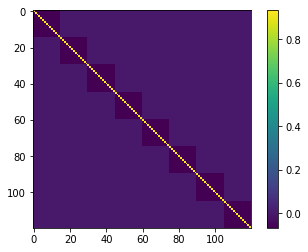

In [406]:
imshow(proj @ proj)

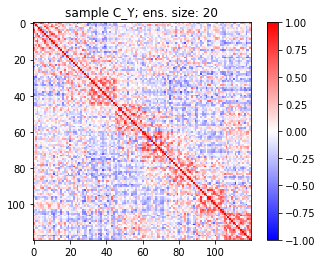

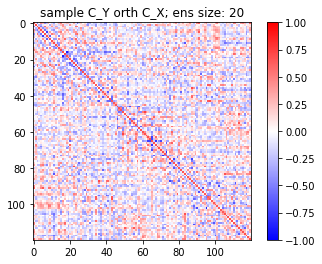

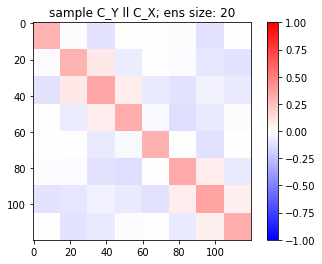

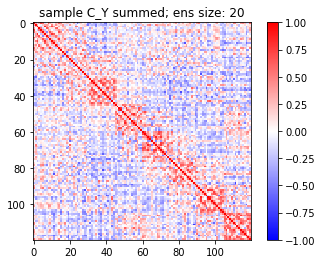

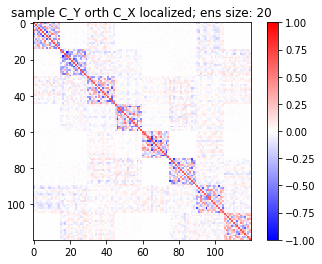

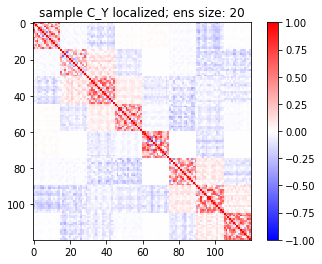

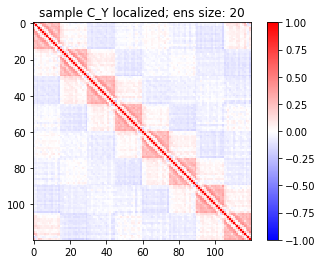

In [416]:
C_Y_sample = np.corrcoef(Y_sample)
# C_Y_sample_orth = proj @ C_Y_sample @ proj
C_Y_sample_ll = (
    VT_X_interp.T
    @ np.diag(np.diag(VT_X_interp @ C_Y_sample @ VT_X_interp.T))
    @ VT_X_interp)
C_Y_sample_orth = C_Y_sample - C_Y_sample_ll
C_Y_sample_sum = C_Y_sample_orth + C_Y_sample_ll
D_inv_sqrt = np.diag(1/np.sqrt(np.diag(C_Y_sample_ll)))
rho_Y_sample_ll = D_inv_sqrt @ C_Y_sample_ll @ D_inv_sqrt
C_Y_sample_orth_loc = rho_Y_sample_ll * C_Y_sample_orth
C_Y_sample_loc = rho_Y_sample_ll * C_Y_sample_orth + C_Y_sample_ll

vmax = np.max([
    np.abs(C_Y_sample).max(),
    np.abs(C_Y_sample_orth).max(),
    np.abs(C_Y_sample_ll).max(),
    np.abs(C_Y_sample_sum).max(),
    np.abs(C_Y_sample_loc).max(),
    np.abs(C_Y_sample_orth_loc).max()])
imshow(C_Y_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y; ens. size: {ens_size}')
imshow(C_Y_sample_orth,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y orth C_X; ens size: {ens_size}')
imshow(C_Y_sample_ll,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y ll C_X; ens size: {ens_size}')
imshow(C_Y_sample_sum,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y summed; ens size: {ens_size}')
imshow(C_Y_sample_orth_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y orth C_X localized; ens size: {ens_size}')
imshow(C_Y_sample_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y localized; ens size: {ens_size}')
imshow(C_Y,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'sample C_Y localized; ens size: {ens_size}')

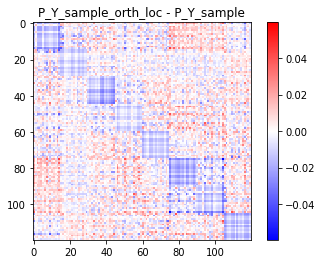

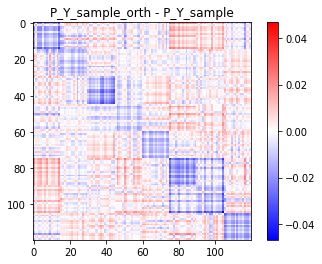

In [352]:
this_diff = P_Y_sample_orth_loc - P_Y_sample
vmax = np.abs(this_diff).max()
imshow(this_diff,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y_sample_orth_loc - P_Y_sample')

this_diff = P_Y_sample_orth - P_Y_sample
vmax = np.abs(this_diff).max()
imshow(this_diff,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Y_sample_orth - P_Y_sample')

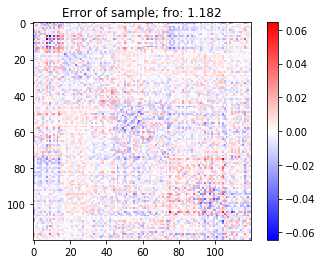

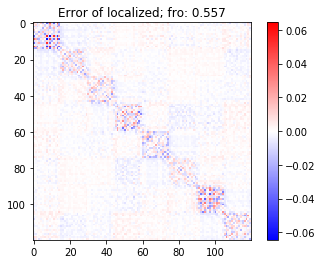

In [338]:
error_sample = P_Y_sample - P_Y
fro_sample = np.round(
    np.linalg.norm(error_sample, ord='fro'),
    decimals=3)
error_localized = P_Y_sample_loc - P_Y
fro_localized = np.round(
    np.linalg.norm(error_localized, ord='fro'),
    decimals=3)
vmax = np.max([
    np.abs(error_sample).max(),
    np.abs(error_localized).max()
])
imshow(error_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of sample; fro: {fro_sample}')
imshow(error_localized,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of localized; fro: {fro_localized}')

In [339]:
def D_KL(P, Q):
    Q_inv = np.linalg.inv(Q)
    tr = np.trace(Q_inv @ P)
    k = np.shape(P)[0]
    Q_det = np.linalg.det(Q)
    P_det = np.linalg.det(P)
    KL = tr - k + np.log(Q_det/P_det)
    return KL

In [340]:
def loc_error(P, P_sample, rho0, norm='fro'):
    [loc] = covariance.generate_circulant(
        J * K, 1.0, rho0, covariance.fft_sqd_exp_1d,
        return_Corr=True, return_sort_ind=False, return_eig=False)
    P_loc = P_sample * loc
    error = P_loc - P
    error = np.linalg.norm(error, ord=norm)
    return error, P_loc

Text(0.5, 1.0, 'Error (2) vs. rho')

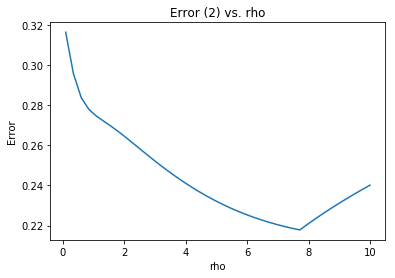

In [341]:
norm = 2
rho_array = np.linspace(.1, 10, 40)
error_array = np.ones_like(rho_array) * np.nan
for count, rho0 in enumerate(rho_array):
    error_array[count], P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0, norm=norm)
    
plt.figure()
plt.plot(rho_array, error_array)
plt.ylabel('Error')
plt.xlabel('rho')
plt.title(f'Error ({norm}) vs. rho')

Text(0.5, 1.0, 'Error (fro) vs. rho')

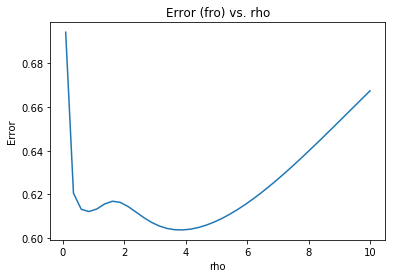

In [342]:
norm = 'fro'
rho_array = np.linspace(.1, 10, 40)
error_array = np.ones_like(rho_array) * np.nan
for count, rho0 in enumerate(rho_array):
    error_array[count], P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0, norm=norm)
    
plt.figure()
plt.plot(rho_array, error_array)
plt.ylabel('Error')
plt.xlabel('rho')
plt.title(f'Error ({norm}) vs. rho')

In [343]:
rho0 = rho_array[np.argmin(error_array)]
err, P_Y_1_loc = loc_error(P_Y, P_Y_sample, rho0)

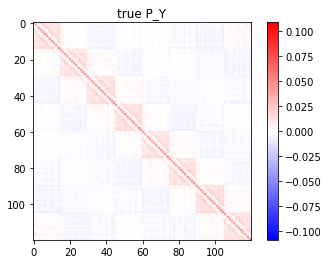

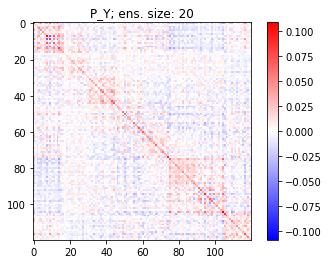

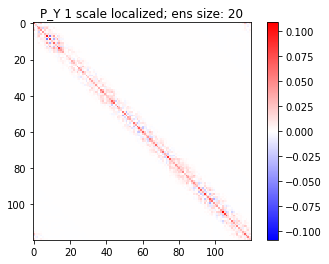

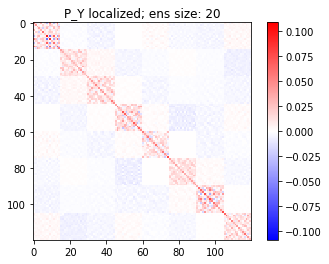

In [344]:
# Plot of Covarainces
vmax = np.max([
    np.abs(P_Y).max(),
    np.abs(P_Y_sample).max(),
    np.abs(P_Y_1_loc).max(),
    np.abs(P_Y_sample_loc).max()])
imshow(P_Y,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'true P_Y')
imshow(P_Y_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y; ens. size: {ens_size}')
imshow(P_Y_1_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y 1 scale localized; ens size: {ens_size}')
imshow(P_Y_sample_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'P_Y localized; ens size: {ens_size}')

Text(0.5, 1.0, 'Variance of system')

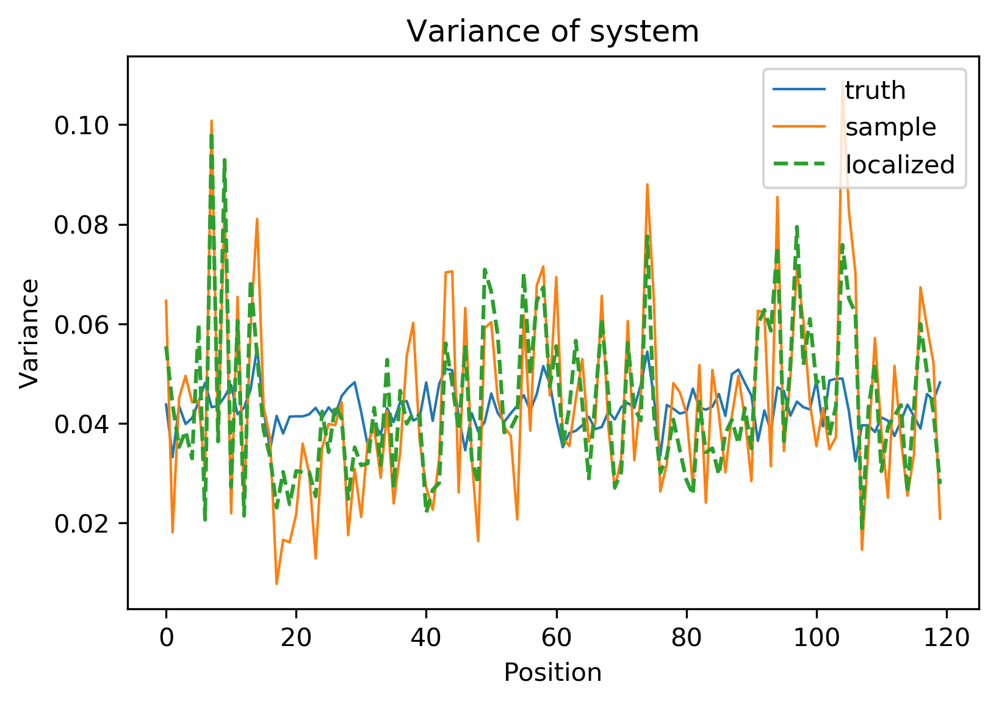

In [345]:
plt.figure(dpi=300)
plt.plot(P_Y.diagonal(), linewidth=1)
plt.plot(P_Y_sample.diagonal(), linewidth=1)
plt.plot(P_Y_sample_loc.diagonal(), linestyle='--')
plt.legend(['truth',
            'sample',
            'localized',
            '1 scale loc'])
plt.xlabel('Position')
plt.ylabel('Variance')
plt.title('Variance of system')

In [346]:
error_1_loc = P_Y_1_loc - P_Y
fro_1_loc = np.round(
    np.linalg.norm(error_1_loc, ord='fro'),
    decimals=3)

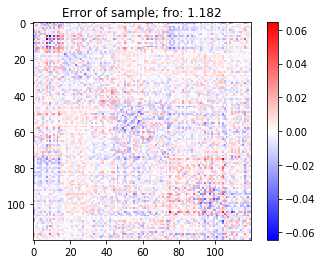

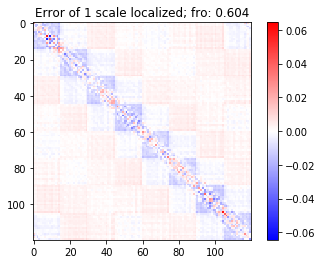

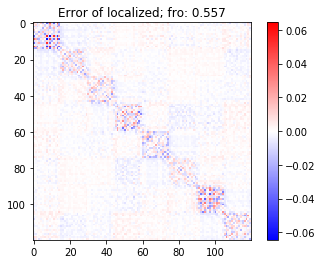

In [347]:
vmax = np.max([
    np.abs(error_sample).max(),
    np.abs(error_localized).max(),
    np.abs(error_1_loc).max()
])
imshow(error_sample,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of sample; fro: {fro_sample}')
imshow(error_1_loc,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of 1 scale localized; fro: {fro_1_loc}')
imshow(error_localized,
       vmax=vmax, vmin=-vmax, cmap='bwr',
       title=f'Error of localized; fro: {fro_localized}')

In [288]:
fro_localized = np.round(
    np.linalg.norm(error_localized, ord=2),
    decimals=3)
fro_1_loc = np.round(
    np.linalg.norm(error_1_loc, ord='fro'),
    decimals=3)
print(f'multi_loc error, frobenius norm: {fro_localized}')
print(f'one scale error, frobenius norm: {fro_1_loc}')

multi_loc error, frobenius norm: 0.253
one scale error, frobenius norm: 0.635
